# Afriat

In [1]:
scan=0.18

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

True

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

tardis.MyModel.setup_wandb(
    wandb_configurations=tardis.config.wandb,
    hyperparams=dict(
        model_params=model_params,
        train_params=train_params,
        dataset_params=dataset_params,
    )
)

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

CUDA backend failed to initialize: Found cuDNN version 8700, but JAX was built against version 8907, which is newer. The copy of cuDNN that is installed must be at least as new as the version against which JAX was built. (Set TF_CPP_MIN_LOG_LEVEL=0 and rerun for more info.)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


W&B logger initialized with the following parameters: 
Entity: inecik-academic
Project: tardis_figures
ID: ifbpzz80
Name: graceful-snowball-111
Tags: tardis, conference, figures, final
Notes: Final runs for Tardis before conference.
URL: https://wandb.ai/inecik-academic/tardis_figures/runs/ifbpzz80
Directory: /lustre/groups/ml01/workspace/kemal.inecik/wandb/run-20240503_101835-ifbpzz80/files



GPU available: True (cuda), used: True


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


You are using a CUDA device ('NVIDIA A100 80GB PCIe') that has Tensor Cores. To properly utilize them, you should set `torch.set_float32_matmul_precision('medium' | 'high')` which will trade-off precision for performance. For more details, read https://pytorch.org/docs/stable/generated/torch.set_float32_matmul_precision.html#torch.set_float32_matmul_precision


LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "
SLURM auto-requeueing enabled. Setting signal handlers.


Training:   0%|                                                                                                                                                                                                                                | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|                                                                                                                                                                                                                             | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2555,3304,9384
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2555,2572,1674,3448,1638,3356
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4506,10737
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 650,805,2355
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 650,630,434,842,411,843
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1078,2732
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|▎                                                                                                                                                                                                                  | 1/600 [00:11<1:53:59, 11.42s/it]

Epoch 1/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:53:59, 11.42s/it, v_num=80_1, total_loss_train=3.69e+3, kl_local_train=43.3]

Epoch 2/600:   0%|▎                                                                                                                                                       | 1/600 [00:11<1:53:59, 11.42s/it, v_num=80_1, total_loss_train=3.69e+3, kl_local_train=43.3]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:14,  7.75s/it, v_num=80_1, total_loss_train=3.69e+3, kl_local_train=43.3]

Epoch 2/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:14,  7.75s/it, v_num=80_1, total_loss_train=3.23e+3, kl_local_train=59.3]

Epoch 3/600:   0%|▌                                                                                                                                                       | 2/600 [00:16<1:17:14,  7.75s/it, v_num=80_1, total_loss_train=3.23e+3, kl_local_train=59.3]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:33,  6.59s/it, v_num=80_1, total_loss_train=3.23e+3, kl_local_train=59.3]

Epoch 3/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:33,  6.59s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=58.1]

Epoch 4/600:   0%|▊                                                                                                                                                       | 3/600 [00:21<1:05:33,  6.59s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=58.1]

Epoch 4/600:   1%|█                                                                                                                                                         | 4/600 [00:27<59:59,  6.04s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=58.1]

Epoch 4/600:   1%|█                                                                                                                                                           | 4/600 [00:27<59:59,  6.04s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=53]

Epoch 5/600:   1%|█                                                                                                                                                           | 4/600 [00:27<59:59,  6.04s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=53]

Epoch 5/600:   1%|█▎                                                                                                                                                          | 5/600 [00:32<56:55,  5.74s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=53]

Epoch 5/600:   1%|█▎                                                                                                                                                        | 5/600 [00:32<56:55,  5.74s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=45.5]

Epoch 6/600:   1%|█▎                                                                                                                                                        | 5/600 [00:33<56:55,  5.74s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=45.5]

Epoch 6/600:   1%|█▌                                                                                                                                                        | 6/600 [00:38<58:30,  5.91s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=45.5]

Epoch 6/600:   1%|▏                     | 6/600 [00:38<58:30,  5.91s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=33.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 7/600:   1%|▏                     | 6/600 [00:38<58:30,  5.91s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=33.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 7/600:   1%|▎                     | 7/600 [00:43<56:10,  5.68s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=33.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 7/600:   1%|▎                      | 7/600 [00:43<56:10,  5.68s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 8/600:   1%|▎                      | 7/600 [00:43<56:10,  5.68s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 8/600:   1%|▎                      | 8/600 [00:48<54:21,  5.51s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=29.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 8/600:   1%|▎                     | 8/600 [00:48<54:21,  5.51s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=27.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 9/600:   1%|▎                     | 8/600 [00:48<54:21,  5.51s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=27.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 9/600:   2%|▎                     | 9/600 [00:53<53:07,  5.39s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=27.6, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 9/600:   2%|▎                     | 9/600 [00:53<53:07,  5.39s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=28.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 10/600:   2%|▎                    | 9/600 [00:53<53:07,  5.39s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=28.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 10/600:   2%|▎                   | 10/600 [00:59<52:16,  5.32s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=28.3, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 10/600:   2%|▎                   | 10/600 [00:59<52:16,  5.32s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=30.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 11/600:   2%|▎                   | 10/600 [01:00<52:16,  5.32s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=30.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 11/600:   2%|▎                   | 11/600 [01:05<54:40,  5.57s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=30.9, metric_mi|status_control_train=0.0186, metric_mi|zone_train=0.00963, metric_mi|time_cat_train=0.0124, metric_mi|mouse_train=0.0353]

Epoch 11/600:   2%|▍                     | 11/600 [01:05<54:40,  5.57s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 12/600:   2%|▍                     | 11/600 [01:05<54:40,  5.57s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 12/600:   2%|▍                     | 12/600 [01:10<53:20,  5.44s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=38.4, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 12/600:   2%|▍                     | 12/600 [01:10<53:20,  5.44s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=48.1, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 13/600:   2%|▍                     | 12/600 [01:10<53:20,  5.44s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=48.1, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 13/600:   2%|▍                     | 13/600 [01:15<52:23,  5.36s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=48.1, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 13/600:   2%|▍                     | 13/600 [01:15<52:23,  5.36s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=57.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 14/600:   2%|▍                     | 13/600 [01:15<52:23,  5.36s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=57.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 14/600:   2%|▌                     | 14/600 [01:20<51:44,  5.30s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=57.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 14/600:   2%|▌                     | 14/600 [01:20<51:44,  5.30s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=66.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 15/600:   2%|▌                     | 14/600 [01:20<51:44,  5.30s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=66.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 15/600:   2%|▌                     | 15/600 [01:25<51:14,  5.26s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=66.2, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 15/600:   2%|▌                       | 15/600 [01:25<51:14,  5.26s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=75, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 16/600:   2%|▌                       | 15/600 [01:26<51:14,  5.26s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=75, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 16/600:   3%|▋                       | 16/600 [01:32<53:48,  5.53s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=75, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0609, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0591]

Epoch 16/600:   3%|▌                    | 16/600 [01:32<53:48,  5.53s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=87.4, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 17/600:   3%|▌                    | 16/600 [01:32<53:48,  5.53s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=87.4, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 17/600:   3%|▌                    | 17/600 [01:37<52:35,  5.41s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=87.4, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 17/600:   3%|▌                    | 17/600 [01:37<52:35,  5.41s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=98.1, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 18/600:   3%|▌                    | 17/600 [01:37<52:35,  5.41s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=98.1, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 18/600:   3%|▋                    | 18/600 [01:42<51:43,  5.33s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=98.1, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 18/600:   3%|▋                     | 18/600 [01:42<51:43,  5.33s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 19/600:   3%|▋                     | 18/600 [01:42<51:43,  5.33s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 19/600:   3%|▋                     | 19/600 [01:47<51:05,  5.28s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=106, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 19/600:   3%|▋                     | 19/600 [01:47<51:05,  5.28s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 20/600:   3%|▋                     | 19/600 [01:47<51:05,  5.28s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:35,  5.23s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=112, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 20/600:   3%|▋                     | 20/600 [01:52<50:35,  5.23s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 21/600:   3%|▋                     | 20/600 [01:53<50:35,  5.23s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 21/600:   4%|▊                     | 21/600 [01:58<53:05,  5.50s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=117, metric_mi|status_control_train=0.0519, metric_mi|zone_train=0.0649, metric_mi|time_cat_train=0.0713, metric_mi|mouse_train=0.0897]

Epoch 21/600:   4%|▊                       | 21/600 [01:58<53:05,  5.50s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 22/600:   4%|▊                       | 21/600 [01:58<53:05,  5.50s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 22/600:   4%|▉                       | 22/600 [02:03<51:56,  5.39s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=121, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 22/600:   4%|▉                       | 22/600 [02:03<51:56,  5.39s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 23/600:   4%|▉                       | 22/600 [02:03<51:56,  5.39s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 23/600:   4%|▉                       | 23/600 [02:08<51:05,  5.31s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=124, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 23/600:   4%|▉                       | 23/600 [02:08<51:05,  5.31s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 24/600:   4%|▉                       | 23/600 [02:08<51:05,  5.31s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 24/600:   4%|▉                       | 24/600 [02:14<50:34,  5.27s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=128, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 24/600:   4%|▉                       | 24/600 [02:14<50:34,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 25/600:   4%|▉                       | 24/600 [02:14<50:34,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 25/600:   4%|█                       | 25/600 [02:19<50:15,  5.24s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 25/600:   4%|█                       | 25/600 [02:19<50:15,  5.24s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 26/600:   4%|█                       | 25/600 [02:20<50:15,  5.24s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 26/600:   4%|█                       | 26/600 [02:25<52:43,  5.51s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.0968, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.118]

Epoch 26/600:   4%|█                        | 26/600 [02:25<52:43,  5.51s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 27/600:   4%|█                        | 26/600 [02:25<52:43,  5.51s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 27/600:   4%|█▏                       | 27/600 [02:30<51:34,  5.40s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 27/600:   4%|█▏                       | 27/600 [02:30<51:34,  5.40s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 28/600:   4%|█▏                       | 27/600 [02:30<51:34,  5.40s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 28/600:   5%|█▏                       | 28/600 [02:35<50:48,  5.33s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=131, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 28/600:   5%|█▏                       | 28/600 [02:35<50:48,  5.33s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 29/600:   5%|█▏                       | 28/600 [02:35<50:48,  5.33s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 29/600:   5%|█▏                       | 29/600 [02:40<50:14,  5.28s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=129, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 29/600:   5%|█▏                       | 29/600 [02:40<50:14,  5.28s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 30/600:   5%|█▏                       | 29/600 [02:40<50:14,  5.28s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 30/600:   5%|█▎                       | 30/600 [02:46<49:53,  5.25s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=130, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 30/600:   5%|█▎                       | 30/600 [02:46<49:53,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 31/600:   5%|█▎                       | 30/600 [02:47<49:53,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 31/600:   5%|█▎                       | 31/600 [02:52<52:18,  5.52s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.109, metric_mi|zone_train=0.0963, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.123]

Epoch 31/600:   5%|█▎                        | 31/600 [02:52<52:18,  5.52s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 32/600:   5%|█▎                        | 31/600 [02:52<52:18,  5.52s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 32/600:   5%|█▍                        | 32/600 [02:57<51:13,  5.41s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 32/600:   5%|█▍                        | 32/600 [02:57<51:13,  5.41s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 33/600:   5%|█▍                        | 32/600 [02:57<51:13,  5.41s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 33/600:   6%|█▍                        | 33/600 [03:02<50:23,  5.33s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=128, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 33/600:   6%|█▍                        | 33/600 [03:02<50:23,  5.33s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 34/600:   6%|█▍                        | 33/600 [03:02<50:23,  5.33s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 34/600:   6%|█▍                        | 34/600 [03:07<49:49,  5.28s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 34/600:   6%|█▍                        | 34/600 [03:07<49:49,  5.28s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 35/600:   6%|█▍                        | 34/600 [03:07<49:49,  5.28s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 35/600:   6%|█▌                        | 35/600 [03:12<49:24,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=129, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 35/600:   6%|█▌                        | 35/600 [03:12<49:24,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=131, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 36/600:   6%|█▌                        | 35/600 [03:13<49:24,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=131, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 36/600:   6%|█▌                        | 36/600 [03:19<51:55,  5.52s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=131, metric_mi|status_control_train=0.119, metric_mi|zone_train=0.134, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.128]

Epoch 36/600:   6%|█▌                         | 36/600 [03:19<51:55,  5.52s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 37/600:   6%|█▌                         | 36/600 [03:19<51:55,  5.52s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 37/600:   6%|█▋                         | 37/600 [03:24<50:49,  5.42s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 37/600:   6%|█▋                         | 37/600 [03:24<50:49,  5.42s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 38/600:   6%|█▋                         | 37/600 [03:24<50:49,  5.42s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 38/600:   6%|█▋                         | 38/600 [03:29<50:00,  5.34s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=134, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 38/600:   6%|█▋                         | 38/600 [03:29<50:00,  5.34s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 39/600:   6%|█▋                         | 38/600 [03:29<50:00,  5.34s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 39/600:   6%|█▊                         | 39/600 [03:34<49:21,  5.28s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=133, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 39/600:   6%|█▊                         | 39/600 [03:34<49:21,  5.28s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 40/600:   6%|█▊                         | 39/600 [03:34<49:21,  5.28s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 40/600:   7%|█▊                         | 40/600 [03:39<48:54,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=132, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 40/600:   7%|█▊                         | 40/600 [03:39<48:54,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=131, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 41/600:   7%|█▊                         | 40/600 [03:40<48:54,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=131, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 41/600:   7%|█▊                         | 41/600 [03:45<51:22,  5.51s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=131, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.154, metric_mi|time_cat_train=0.142, metric_mi|mouse_train=0.132]

Epoch 41/600:   7%|█▊                         | 41/600 [03:45<51:22,  5.51s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=130, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 42/600:   7%|█▊                         | 41/600 [03:45<51:22,  5.51s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=130, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 42/600:   7%|█▉                         | 42/600 [03:51<50:17,  5.41s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=130, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 42/600:   7%|█▉                         | 42/600 [03:51<50:17,  5.41s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=128, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 43/600:   7%|█▉                         | 42/600 [03:51<50:17,  5.41s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=128, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 43/600:   7%|█▉                         | 43/600 [03:56<49:29,  5.33s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=128, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 43/600:   7%|█▉                         | 43/600 [03:56<49:29,  5.33s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=127, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 44/600:   7%|█▉                         | 43/600 [03:56<49:29,  5.33s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=127, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 44/600:   7%|█▉                         | 44/600 [04:01<48:53,  5.28s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=127, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 44/600:   7%|█▉                         | 44/600 [04:01<48:53,  5.28s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=127, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 45/600:   7%|█▉                         | 44/600 [04:01<48:53,  5.28s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=127, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 45/600:   8%|██                         | 45/600 [04:06<48:26,  5.24s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=127, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 45/600:   8%|██                         | 45/600 [04:06<48:26,  5.24s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=128, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 46/600:   8%|██                         | 45/600 [04:07<48:26,  5.24s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=128, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 46/600:   8%|██                         | 46/600 [04:12<50:52,  5.51s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=128, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.16, metric_mi|time_cat_train=0.148, metric_mi|mouse_train=0.136]

Epoch 46/600:   8%|█▉                        | 46/600 [04:12<50:52,  5.51s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=127, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 47/600:   8%|█▉                        | 46/600 [04:12<50:52,  5.51s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=127, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 47/600:   8%|██                        | 47/600 [04:17<49:49,  5.41s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=127, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 47/600:   8%|██                        | 47/600 [04:17<49:49,  5.41s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 48/600:   8%|██                        | 47/600 [04:17<49:49,  5.41s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 48/600:   8%|██                        | 48/600 [04:22<49:01,  5.33s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 48/600:   8%|██                        | 48/600 [04:22<49:01,  5.33s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 49/600:   8%|██                        | 48/600 [04:22<49:01,  5.33s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 49/600:   8%|██                        | 49/600 [04:28<48:28,  5.28s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=128, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 49/600:   8%|██                        | 49/600 [04:28<48:28,  5.28s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=126, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 50/600:   8%|██                        | 49/600 [04:28<48:28,  5.28s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=126, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 50/600:   8%|██▏                       | 50/600 [04:33<47:59,  5.24s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=126, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 50/600:   8%|██▏                       | 50/600 [04:33<47:59,  5.24s/it, v_num=80_1, total_loss_train=3.23e+3, kl_local_train=127, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 51/600:   8%|██▏                       | 50/600 [04:34<47:59,  5.24s/it, v_num=80_1, total_loss_train=3.23e+3, kl_local_train=127, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 51/600:   8%|██▏                       | 51/600 [04:39<50:21,  5.50s/it, v_num=80_1, total_loss_train=3.23e+3, kl_local_train=127, metric_mi|status_control_train=0.187, metric_mi|zone_train=0.163, metric_mi|time_cat_train=0.152, metric_mi|mouse_train=0.138]

Epoch 51/600:   8%|██▏                       | 51/600 [04:39<50:21,  5.50s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 52/600:   8%|██▏                       | 51/600 [04:39<50:21,  5.50s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 52/600:   9%|██▎                       | 52/600 [04:44<49:15,  5.39s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=125, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 52/600:   9%|██▎                       | 52/600 [04:44<49:15,  5.39s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=124, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 53/600:   9%|██▎                       | 52/600 [04:44<49:15,  5.39s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=124, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 53/600:   9%|██▎                       | 53/600 [04:49<48:27,  5.31s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=124, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 53/600:   9%|██▎                       | 53/600 [04:49<48:27,  5.31s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=124, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 54/600:   9%|██▎                       | 53/600 [04:49<48:27,  5.31s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=124, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 54/600:   9%|██▎                       | 54/600 [04:54<47:58,  5.27s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=124, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 54/600:   9%|██▎                       | 54/600 [04:54<47:58,  5.27s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=121, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 55/600:   9%|██▎                       | 54/600 [04:54<47:58,  5.27s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=121, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 55/600:   9%|██▍                       | 55/600 [04:59<47:31,  5.23s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=121, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 55/600:   9%|██▍                       | 55/600 [04:59<47:31,  5.23s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=120, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 56/600:   9%|██▍                       | 55/600 [05:00<47:31,  5.23s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=120, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 56/600:   9%|██▍                       | 56/600 [05:06<49:48,  5.49s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=120, metric_mi|status_control_train=0.196, metric_mi|zone_train=0.165, metric_mi|time_cat_train=0.154, metric_mi|mouse_train=0.139]

Epoch 56/600:   9%|██▌                        | 56/600 [05:06<49:48,  5.49s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=117, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 57/600:   9%|██▌                        | 56/600 [05:06<49:48,  5.49s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=117, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 57/600:  10%|██▌                        | 57/600 [05:11<48:40,  5.38s/it, v_num=80_1, total_loss_train=3.22e+3, kl_local_train=117, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 57/600:  10%|██▌                        | 57/600 [05:11<48:40,  5.38s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 58/600:  10%|██▌                        | 57/600 [05:11<48:40,  5.38s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 58/600:  10%|██▌                        | 58/600 [05:16<48:00,  5.31s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=118, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 58/600:  10%|██▌                        | 58/600 [05:16<48:00,  5.31s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 59/600:  10%|██▌                        | 58/600 [05:16<48:00,  5.31s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 59/600:  10%|██▋                        | 59/600 [05:21<47:28,  5.26s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=117, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 59/600:  10%|██▋                        | 59/600 [05:21<47:28,  5.26s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 60/600:  10%|██▋                        | 59/600 [05:21<47:28,  5.26s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 60/600:  10%|██▋                        | 60/600 [05:26<46:57,  5.22s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 60/600:  10%|██▋                        | 60/600 [05:26<46:57,  5.22s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 61/600:  10%|██▋                        | 60/600 [05:27<46:57,  5.22s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 61/600:  10%|██▋                        | 61/600 [05:32<49:20,  5.49s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=114, metric_mi|status_control_train=0.189, metric_mi|zone_train=0.162, metric_mi|time_cat_train=0.15, metric_mi|mouse_train=0.135]

Epoch 61/600:  10%|██▋                       | 61/600 [05:32<49:20,  5.49s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 62/600:  10%|██▋                       | 61/600 [05:32<49:20,  5.49s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 62/600:  10%|██▋                       | 62/600 [05:37<48:13,  5.38s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=112, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 62/600:  10%|██▋                       | 62/600 [05:37<48:13,  5.38s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 63/600:  10%|██▋                       | 62/600 [05:37<48:13,  5.38s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 63/600:  10%|██▋                       | 63/600 [05:42<47:24,  5.30s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 63/600:  10%|██▋                       | 63/600 [05:42<47:24,  5.30s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 64/600:  10%|██▋                       | 63/600 [05:42<47:24,  5.30s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 64/600:  11%|██▊                       | 64/600 [05:48<46:51,  5.24s/it, v_num=80_1, total_loss_train=3.21e+3, kl_local_train=111, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 64/600:  11%|██▉                        | 64/600 [05:48<46:51,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 65/600:  11%|██▉                        | 64/600 [05:48<46:51,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 65/600:  11%|██▉                        | 65/600 [05:53<46:16,  5.19s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=109, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 65/600:  11%|██▉                        | 65/600 [05:53<46:16,  5.19s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 66/600:  11%|██▉                        | 65/600 [05:54<46:16,  5.19s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 66/600:  11%|██▉                        | 66/600 [05:59<48:48,  5.48s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.158, metric_mi|time_cat_train=0.149, metric_mi|mouse_train=0.134]

Epoch 66/600:  11%|██▉                        | 66/600 [05:59<48:48,  5.48s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 67/600:  11%|██▉                        | 66/600 [05:59<48:48,  5.48s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 67/600:  11%|███                        | 67/600 [06:04<47:43,  5.37s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=108, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 67/600:  11%|███                        | 67/600 [06:04<47:43,  5.37s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 68/600:  11%|███                        | 67/600 [06:04<47:43,  5.37s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 68/600:  11%|███                        | 68/600 [06:09<46:55,  5.29s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=106, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 68/600:  11%|███                        | 68/600 [06:09<46:55,  5.29s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 69/600:  11%|███                        | 68/600 [06:09<46:55,  5.29s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 69/600:  12%|███                        | 69/600 [06:14<46:22,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 69/600:  12%|███                        | 69/600 [06:14<46:22,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 70/600:  12%|███                        | 69/600 [06:14<46:22,  5.24s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 70/600:  12%|███▏                       | 70/600 [06:19<45:54,  5.20s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=105, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 70/600:  12%|███▏                       | 70/600 [06:19<45:54,  5.20s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 71/600:  12%|███▏                       | 70/600 [06:20<45:54,  5.20s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 71/600:  12%|███▏                       | 71/600 [06:25<48:17,  5.48s/it, v_num=80_1, total_loss_train=3.2e+3, kl_local_train=103, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.153, metric_mi|time_cat_train=0.147, metric_mi|mouse_train=0.133]

Epoch 71/600:  12%|███▏                       | 71/600 [06:25<48:17,  5.48s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 72/600:  12%|███▏                       | 71/600 [06:25<48:17,  5.48s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 72/600:  12%|███▏                       | 72/600 [06:30<47:13,  5.37s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=102, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 72/600:  12%|███▏                       | 72/600 [06:30<47:13,  5.37s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 73/600:  12%|███▏                       | 72/600 [06:30<47:13,  5.37s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 73/600:  12%|███▎                       | 73/600 [06:36<46:37,  5.31s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 73/600:  12%|███▎                       | 73/600 [06:36<46:37,  5.31s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 74/600:  12%|███▎                       | 73/600 [06:36<46:37,  5.31s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 74/600:  12%|███▎                       | 74/600 [06:41<45:59,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=101, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 74/600:  12%|███▎                       | 74/600 [06:41<45:59,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 75/600:  12%|███▎                       | 74/600 [06:41<45:59,  5.25s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 75/600:  12%|███▍                       | 75/600 [06:46<45:42,  5.22s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 75/600:  12%|███▎                      | 75/600 [06:46<45:42,  5.22s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 76/600:  12%|███▎                      | 75/600 [06:47<45:42,  5.22s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 76/600:  13%|███▎                      | 76/600 [06:52<48:03,  5.50s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.184, metric_mi|zone_train=0.15, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 76/600:  13%|███▌                        | 76/600 [06:52<48:03,  5.50s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 77/600:  13%|███▌                        | 76/600 [06:52<48:03,  5.50s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 77/600:  13%|███▌                        | 77/600 [06:57<46:56,  5.39s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 77/600:  13%|███▎                      | 77/600 [06:57<46:56,  5.39s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 78/600:  13%|███▎                      | 77/600 [06:57<46:56,  5.39s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 78/600:  13%|███▍                      | 78/600 [07:02<46:11,  5.31s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=99.3, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 78/600:  13%|███▍                      | 78/600 [07:02<46:11,  5.31s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 79/600:  13%|███▍                      | 78/600 [07:02<46:11,  5.31s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 79/600:  13%|███▍                      | 79/600 [07:07<45:43,  5.27s/it, v_num=80_1, total_loss_train=3.19e+3, kl_local_train=97.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 79/600:  13%|███▍                      | 79/600 [07:07<45:43,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 80/600:  13%|███▍                      | 79/600 [07:07<45:43,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 80/600:  13%|███▍                      | 80/600 [07:13<45:09,  5.21s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=96.4, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 80/600:  13%|███▍                      | 80/600 [07:13<45:09,  5.21s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=95.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 81/600:  13%|███▍                      | 80/600 [07:14<45:09,  5.21s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=95.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 81/600:  14%|███▌                      | 81/600 [07:19<47:19,  5.47s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=95.7, metric_mi|status_control_train=0.19, metric_mi|zone_train=0.148, metric_mi|time_cat_train=0.146, metric_mi|mouse_train=0.133]

Epoch 81/600:  14%|███▌                      | 81/600 [07:19<47:19,  5.47s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=95.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 82/600:  14%|███▌                      | 81/600 [07:19<47:19,  5.47s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=95.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 82/600:  14%|███▌                      | 82/600 [07:24<46:11,  5.35s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=95.6, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 82/600:  14%|███▌                      | 82/600 [07:24<46:11,  5.35s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=94.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 83/600:  14%|███▌                      | 82/600 [07:24<46:11,  5.35s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=94.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 83/600:  14%|███▌                      | 83/600 [07:29<45:22,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=94.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 83/600:  14%|███▌                      | 83/600 [07:29<45:22,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=93.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 84/600:  14%|███▌                      | 83/600 [07:29<45:22,  5.27s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=93.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 84/600:  14%|███▋                      | 84/600 [07:34<45:01,  5.24s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=93.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 84/600:  14%|███▋                      | 84/600 [07:34<45:01,  5.24s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=93.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 85/600:  14%|███▋                      | 84/600 [07:34<45:01,  5.24s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=93.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 85/600:  14%|███▋                      | 85/600 [07:39<44:35,  5.19s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=93.1, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 85/600:  14%|███▋                      | 85/600 [07:39<44:35,  5.19s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=92.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 86/600:  14%|███▋                      | 85/600 [07:40<44:35,  5.19s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=92.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 86/600:  14%|███▋                      | 86/600 [07:45<46:50,  5.47s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=92.2, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.144, metric_mi|time_cat_train=0.141, metric_mi|mouse_train=0.13]

Epoch 86/600:  14%|███▌                     | 86/600 [07:45<46:50,  5.47s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 87/600:  14%|███▌                     | 86/600 [07:45<46:50,  5.47s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 87/600:  14%|███▌                     | 87/600 [07:50<45:47,  5.36s/it, v_num=80_1, total_loss_train=3.18e+3, kl_local_train=91.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 87/600:  14%|███▌                     | 87/600 [07:50<45:47,  5.36s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 88/600:  14%|███▌                     | 87/600 [07:50<45:47,  5.36s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 88/600:  15%|███▋                     | 88/600 [07:55<45:01,  5.28s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.9, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 88/600:  15%|███▋                     | 88/600 [07:55<45:01,  5.28s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 89/600:  15%|███▋                     | 88/600 [07:55<45:01,  5.28s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 89/600:  15%|███▋                     | 89/600 [08:00<44:24,  5.21s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 89/600:  15%|███▋                     | 89/600 [08:00<44:24,  5.21s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 90/600:  15%|███▋                     | 89/600 [08:00<44:24,  5.21s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 90/600:  15%|███▊                     | 90/600 [08:05<44:00,  5.18s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 90/600:  15%|███▊                     | 90/600 [08:05<44:00,  5.18s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 91/600:  15%|███▊                     | 90/600 [08:06<44:00,  5.18s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 91/600:  15%|███▊                     | 91/600 [08:12<46:30,  5.48s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=90.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.143, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.125]

Epoch 91/600:  15%|███▊                     | 91/600 [08:12<46:30,  5.48s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=89.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 92/600:  15%|███▊                     | 91/600 [08:12<46:30,  5.48s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=89.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 92/600:  15%|███▊                     | 92/600 [08:17<45:32,  5.38s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=89.7, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 92/600:  15%|███▊                     | 92/600 [08:17<45:32,  5.38s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 93/600:  15%|███▊                     | 92/600 [08:17<45:32,  5.38s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 93/600:  16%|███▉                     | 93/600 [08:22<45:00,  5.33s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 93/600:  16%|███▉                     | 93/600 [08:22<45:00,  5.33s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 94/600:  16%|███▉                     | 93/600 [08:22<45:00,  5.33s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 94/600:  16%|███▉                     | 94/600 [08:27<44:20,  5.26s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 94/600:  16%|████▏                      | 94/600 [08:27<44:20,  5.26s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 95/600:  16%|████▏                      | 94/600 [08:27<44:20,  5.26s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 95/600:  16%|████▎                      | 95/600 [08:32<43:50,  5.21s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=88, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 95/600:  16%|███▉                     | 95/600 [08:32<43:50,  5.21s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=87.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 96/600:  16%|███▉                     | 95/600 [08:33<43:50,  5.21s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=87.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 96/600:  16%|████                     | 96/600 [08:38<46:00,  5.48s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=87.6, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.142, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.124]

Epoch 96/600:  16%|████▏                     | 96/600 [08:38<46:00,  5.48s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=86.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 97/600:  16%|████▏                     | 96/600 [08:38<46:00,  5.48s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=86.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 97/600:  16%|████▏                     | 97/600 [08:43<44:58,  5.36s/it, v_num=80_1, total_loss_train=3.17e+3, kl_local_train=86.6, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 97/600:  16%|████▏                     | 97/600 [08:43<44:58,  5.36s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 98/600:  16%|████▏                     | 97/600 [08:43<44:58,  5.36s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 98/600:  16%|████▏                     | 98/600 [08:48<44:13,  5.29s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.9, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 98/600:  16%|████▏                     | 98/600 [08:48<44:13,  5.29s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 99/600:  16%|████▏                     | 98/600 [08:48<44:13,  5.29s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 99/600:  16%|████▎                     | 99/600 [08:54<43:39,  5.23s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.7, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 99/600:  16%|████▎                     | 99/600 [08:54<43:39,  5.23s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 100/600:  16%|████▏                    | 99/600 [08:54<43:39,  5.23s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 100/600:  17%|████                    | 100/600 [08:59<43:14,  5.19s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=85.1, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 100/600:  17%|████                    | 100/600 [08:59<43:14,  5.19s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=84.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 101/600:  17%|████                    | 100/600 [09:00<43:14,  5.19s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=84.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 101/600:  17%|████                    | 101/600 [09:05<45:23,  5.46s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=84.8, metric_mi|status_control_train=0.18, metric_mi|zone_train=0.138, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 101/600:  17%|███▊                   | 101/600 [09:05<45:23,  5.46s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 102/600:  17%|███▊                   | 101/600 [09:05<45:23,  5.46s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 102/600:  17%|███▉                   | 102/600 [09:10<44:24,  5.35s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=84.5, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 102/600:  17%|███▉                   | 102/600 [09:10<44:24,  5.35s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=83.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 103/600:  17%|███▉                   | 102/600 [09:10<44:24,  5.35s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=83.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 103/600:  17%|███▉                   | 103/600 [09:15<43:41,  5.27s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=83.9, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 103/600:  17%|███▉                   | 103/600 [09:15<43:41,  5.27s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 104/600:  17%|███▉                   | 103/600 [09:15<43:41,  5.27s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 104/600:  17%|███▉                   | 104/600 [09:20<43:11,  5.22s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=83.3, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 104/600:  17%|███▉                   | 104/600 [09:20<43:11,  5.22s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=82.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 105/600:  17%|███▉                   | 104/600 [09:20<43:11,  5.22s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=82.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 105/600:  18%|████                   | 105/600 [09:25<42:45,  5.18s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=82.8, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 105/600:  18%|████                   | 105/600 [09:25<42:45,  5.18s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 106/600:  18%|████                   | 105/600 [09:26<42:45,  5.18s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 106/600:  18%|████                   | 106/600 [09:31<44:55,  5.46s/it, v_num=80_1, total_loss_train=3.16e+3, kl_local_train=82.4, metric_mi|status_control_train=0.182, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 106/600:  18%|████                   | 106/600 [09:31<44:55,  5.46s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 107/600:  18%|████                   | 106/600 [09:31<44:55,  5.46s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 107/600:  18%|████                   | 107/600 [09:36<43:56,  5.35s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 107/600:  18%|████                   | 107/600 [09:36<43:56,  5.35s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 108/600:  18%|████                   | 107/600 [09:36<43:56,  5.35s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 108/600:  18%|████▏                  | 108/600 [09:42<43:23,  5.29s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 108/600:  18%|████▏                  | 108/600 [09:42<43:23,  5.29s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 109/600:  18%|████▏                  | 108/600 [09:42<43:23,  5.29s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 109/600:  18%|████▏                  | 109/600 [09:47<42:54,  5.24s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=81.2, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 109/600:  18%|████▏                  | 109/600 [09:47<42:54,  5.24s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=80.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 110/600:  18%|████▏                  | 109/600 [09:47<42:54,  5.24s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=80.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 110/600:  18%|████▏                  | 110/600 [09:52<42:27,  5.20s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=80.7, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 110/600:  18%|████▏                  | 110/600 [09:52<42:27,  5.20s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 111/600:  18%|████▏                  | 110/600 [09:53<42:27,  5.20s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 111/600:  18%|████▎                  | 111/600 [09:58<44:46,  5.49s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=80.4, metric_mi|status_control_train=0.178, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 111/600:  18%|████▎                  | 111/600 [09:58<44:46,  5.49s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 112/600:  18%|████▎                  | 111/600 [09:58<44:46,  5.49s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 112/600:  19%|████▎                  | 112/600 [10:03<43:50,  5.39s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.6, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 112/600:  19%|████▎                  | 112/600 [10:03<43:50,  5.39s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 113/600:  19%|████▎                  | 112/600 [10:03<43:50,  5.39s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 113/600:  19%|████▎                  | 113/600 [10:08<43:10,  5.32s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.9, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 113/600:  19%|████▎                  | 113/600 [10:08<43:10,  5.32s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 114/600:  19%|████▎                  | 113/600 [10:08<43:10,  5.32s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 114/600:  19%|████▎                  | 114/600 [10:13<42:41,  5.27s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 114/600:  19%|████▎                  | 114/600 [10:13<42:41,  5.27s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 115/600:  19%|████▎                  | 114/600 [10:13<42:41,  5.27s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 115/600:  19%|████▍                  | 115/600 [10:19<42:20,  5.24s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=79.4, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 115/600:  19%|████▍                  | 115/600 [10:19<42:20,  5.24s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 116/600:  19%|████▍                  | 115/600 [10:20<42:20,  5.24s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 116/600:  19%|████▍                  | 116/600 [10:25<44:32,  5.52s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=78.7, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.123]

Epoch 116/600:  19%|████▋                   | 116/600 [10:25<44:32,  5.52s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=78.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 117/600:  19%|████▋                   | 116/600 [10:25<44:32,  5.52s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=78.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 117/600:  20%|████▋                   | 117/600 [10:30<43:33,  5.41s/it, v_num=80_1, total_loss_train=3.15e+3, kl_local_train=78.1, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 117/600:  20%|█████                     | 117/600 [10:30<43:33,  5.41s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=78, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 118/600:  20%|█████                     | 117/600 [10:30<43:33,  5.41s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=78, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 118/600:  20%|█████                     | 118/600 [10:35<42:41,  5.32s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=78, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 118/600:  20%|████▋                   | 118/600 [10:35<42:41,  5.32s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 119/600:  20%|████▋                   | 118/600 [10:35<42:41,  5.32s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 119/600:  20%|████▊                   | 119/600 [10:40<42:02,  5.24s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=77.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 119/600:  20%|████▊                   | 119/600 [10:40<42:02,  5.24s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=77.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 120/600:  20%|████▊                   | 119/600 [10:40<42:02,  5.24s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=77.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 120/600:  20%|████▊                   | 120/600 [10:45<41:39,  5.21s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=77.7, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 120/600:  20%|████▊                   | 120/600 [10:45<41:39,  5.21s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 121/600:  20%|████▊                   | 120/600 [10:46<41:39,  5.21s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 121/600:  20%|████▊                   | 121/600 [10:51<43:46,  5.48s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.8, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 121/600:  20%|████▊                   | 121/600 [10:51<43:46,  5.48s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 122/600:  20%|████▊                   | 121/600 [10:51<43:46,  5.48s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 122/600:  20%|████▉                   | 122/600 [10:56<42:49,  5.38s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 122/600:  20%|████▉                   | 122/600 [10:56<42:49,  5.38s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 123/600:  20%|████▉                   | 122/600 [10:56<42:49,  5.38s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 123/600:  20%|████▉                   | 123/600 [11:02<42:08,  5.30s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 123/600:  20%|████▉                   | 123/600 [11:02<42:08,  5.30s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 124/600:  20%|████▉                   | 123/600 [11:02<42:08,  5.30s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 124/600:  21%|████▉                   | 124/600 [11:07<41:31,  5.23s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 124/600:  21%|█████▎                    | 124/600 [11:07<41:31,  5.23s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 125/600:  21%|█████▎                    | 124/600 [11:07<41:31,  5.23s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 125/600:  21%|█████▍                    | 125/600 [11:12<41:01,  5.18s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=76, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 125/600:  21%|█████                   | 125/600 [11:12<41:01,  5.18s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 126/600:  21%|█████                   | 125/600 [11:13<41:01,  5.18s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 126/600:  21%|█████                   | 126/600 [11:18<43:01,  5.45s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.128, metric_mi|mouse_train=0.12]

Epoch 126/600:  21%|████▊                  | 126/600 [11:18<43:01,  5.45s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 127/600:  21%|████▊                  | 126/600 [11:18<43:01,  5.45s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 127/600:  21%|████▊                  | 127/600 [11:23<42:04,  5.34s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 127/600:  21%|████▊                  | 127/600 [11:23<42:04,  5.34s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 128/600:  21%|████▊                  | 127/600 [11:23<42:04,  5.34s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 128/600:  21%|████▉                  | 128/600 [11:28<41:23,  5.26s/it, v_num=80_1, total_loss_train=3.14e+3, kl_local_train=75.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 128/600:  21%|████▉                  | 128/600 [11:28<41:23,  5.26s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 129/600:  21%|████▉                  | 128/600 [11:28<41:23,  5.26s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 129/600:  22%|████▉                  | 129/600 [11:33<40:52,  5.21s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.9, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 129/600:  22%|████▉                  | 129/600 [11:33<40:52,  5.21s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 130/600:  22%|████▉                  | 129/600 [11:33<40:52,  5.21s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 130/600:  22%|████▉                  | 130/600 [11:38<40:28,  5.17s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 130/600:  22%|████▉                  | 130/600 [11:38<40:28,  5.17s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 131/600:  22%|████▉                  | 130/600 [11:39<40:28,  5.17s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 131/600:  22%|█████                  | 131/600 [11:44<42:29,  5.44s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=74.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.124, metric_mi|mouse_train=0.118]

Epoch 131/600:  22%|█████                  | 131/600 [11:44<42:29,  5.44s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.9, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 132/600:  22%|█████                  | 131/600 [11:44<42:29,  5.44s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.9, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 132/600:  22%|█████                  | 132/600 [11:49<41:43,  5.35s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.9, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 132/600:  22%|█████                  | 132/600 [11:49<41:43,  5.35s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 133/600:  22%|█████                  | 132/600 [11:49<41:43,  5.35s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 133/600:  22%|█████                  | 133/600 [11:54<41:06,  5.28s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.8, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 133/600:  22%|█████                  | 133/600 [11:54<41:06,  5.28s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 134/600:  22%|█████                  | 133/600 [11:54<41:06,  5.28s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 134/600:  22%|█████▏                 | 134/600 [11:59<40:34,  5.22s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 134/600:  22%|█████▏                 | 134/600 [11:59<40:34,  5.22s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 135/600:  22%|█████▏                 | 134/600 [11:59<40:34,  5.22s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 135/600:  22%|█████▏                 | 135/600 [12:05<40:15,  5.20s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=73.2, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 135/600:  22%|█████▏                 | 135/600 [12:05<40:15,  5.20s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 136/600:  22%|█████▏                 | 135/600 [12:06<40:15,  5.20s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 136/600:  23%|█████▏                 | 136/600 [12:11<42:22,  5.48s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.121, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.117]

Epoch 136/600:  23%|█████▏                 | 136/600 [12:11<42:22,  5.48s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 137/600:  23%|█████▏                 | 136/600 [12:11<42:22,  5.48s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 137/600:  23%|█████▎                 | 137/600 [12:16<41:27,  5.37s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.9, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 137/600:  23%|█████▎                 | 137/600 [12:16<41:27,  5.37s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 138/600:  23%|█████▎                 | 137/600 [12:16<41:27,  5.37s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 138/600:  23%|█████▎                 | 138/600 [12:21<40:49,  5.30s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 138/600:  23%|█████▊                   | 138/600 [12:21<40:49,  5.30s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 139/600:  23%|█████▊                   | 138/600 [12:21<40:49,  5.30s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 139/600:  23%|█████▊                   | 139/600 [12:26<40:13,  5.23s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 139/600:  23%|█████▎                 | 139/600 [12:26<40:13,  5.23s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 140/600:  23%|█████▎                 | 139/600 [12:26<40:13,  5.23s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 140/600:  23%|█████▎                 | 140/600 [12:31<39:44,  5.18s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=72.3, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 140/600:  23%|█████▎                 | 140/600 [12:31<39:44,  5.18s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 141/600:  23%|█████▎                 | 140/600 [12:32<39:44,  5.18s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 141/600:  24%|█████▍                 | 141/600 [12:37<41:40,  5.45s/it, v_num=80_1, total_loss_train=3.13e+3, kl_local_train=71.7, metric_mi|status_control_train=0.162, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.121, metric_mi|mouse_train=0.115]

Epoch 141/600:  24%|█████▋                  | 141/600 [12:37<41:40,  5.45s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 142/600:  24%|█████▋                  | 141/600 [12:37<41:40,  5.45s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 142/600:  24%|█████▋                  | 142/600 [12:42<40:44,  5.34s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.6, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 142/600:  24%|█████▋                  | 142/600 [12:42<40:44,  5.34s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 143/600:  24%|█████▋                  | 142/600 [12:42<40:44,  5.34s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 143/600:  24%|█████▋                  | 143/600 [12:47<40:04,  5.26s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.3, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 143/600:  24%|█████▋                  | 143/600 [12:47<40:04,  5.26s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 144/600:  24%|█████▋                  | 143/600 [12:47<40:04,  5.26s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 144/600:  24%|█████▊                  | 144/600 [12:52<39:35,  5.21s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 144/600:  24%|█████▊                  | 144/600 [12:52<39:35,  5.21s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 145/600:  24%|█████▊                  | 144/600 [12:52<39:35,  5.21s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 145/600:  24%|█████▊                  | 145/600 [12:58<39:12,  5.17s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=71.2, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 145/600:  24%|█████▊                  | 145/600 [12:58<39:12,  5.17s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 146/600:  24%|█████▊                  | 145/600 [12:59<39:12,  5.17s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 146/600:  24%|█████▊                  | 146/600 [13:04<41:09,  5.44s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.4, metric_mi|status_control_train=0.161, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.12, metric_mi|mouse_train=0.115]

Epoch 146/600:  24%|█████▌                 | 146/600 [13:04<41:09,  5.44s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 147/600:  24%|█████▌                 | 146/600 [13:04<41:09,  5.44s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 147/600:  24%|█████▋                 | 147/600 [13:09<40:16,  5.33s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.3, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 147/600:  24%|█████▋                 | 147/600 [13:09<40:16,  5.33s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 148/600:  24%|█████▋                 | 147/600 [13:09<40:16,  5.33s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 148/600:  25%|█████▋                 | 148/600 [13:14<39:53,  5.30s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70.2, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 148/600:  25%|██████▏                  | 148/600 [13:14<39:53,  5.30s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 149/600:  25%|██████▏                  | 148/600 [13:14<39:53,  5.30s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 149/600:  25%|██████▏                  | 149/600 [13:19<39:18,  5.23s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 149/600:  25%|██████▏                  | 149/600 [13:19<39:18,  5.23s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 150/600:  25%|██████▏                  | 149/600 [13:19<39:18,  5.23s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 150/600:  25%|██████▎                  | 150/600 [13:24<39:00,  5.20s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=70, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 150/600:  25%|█████▊                 | 150/600 [13:24<39:00,  5.20s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 151/600:  25%|█████▊                 | 150/600 [13:25<39:00,  5.20s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 151/600:  25%|█████▊                 | 151/600 [13:30<40:52,  5.46s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.7, metric_mi|status_control_train=0.159, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.119, metric_mi|mouse_train=0.115]

Epoch 151/600:  25%|██████                  | 151/600 [13:30<40:52,  5.46s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 152/600:  25%|██████                  | 151/600 [13:30<40:52,  5.46s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 152/600:  25%|██████                  | 152/600 [13:35<39:54,  5.34s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 152/600:  25%|██████                  | 152/600 [13:35<39:54,  5.34s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 153/600:  25%|██████                  | 152/600 [13:35<39:54,  5.34s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 153/600:  26%|██████                  | 153/600 [13:40<39:14,  5.27s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=69.4, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 153/600:  26%|██████                  | 153/600 [13:40<39:14,  5.27s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=68.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 154/600:  26%|██████                  | 153/600 [13:40<39:14,  5.27s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=68.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 154/600:  26%|██████▏                 | 154/600 [13:45<38:44,  5.21s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=68.9, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 154/600:  26%|██████▏                 | 154/600 [13:45<38:44,  5.21s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 155/600:  26%|██████▏                 | 154/600 [13:45<38:44,  5.21s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 155/600:  26%|██████▏                 | 155/600 [13:51<38:36,  5.20s/it, v_num=80_1, total_loss_train=3.12e+3, kl_local_train=68.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 155/600:  26%|██████▏                 | 155/600 [13:51<38:36,  5.20s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 156/600:  26%|██████▏                 | 155/600 [13:52<38:36,  5.20s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 156/600:  26%|██████▏                 | 156/600 [13:57<40:30,  5.48s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.114, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.113]

Epoch 156/600:  26%|█████▉                 | 156/600 [13:57<40:30,  5.48s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 157/600:  26%|█████▉                 | 156/600 [13:57<40:30,  5.48s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 157/600:  26%|██████                 | 157/600 [14:02<39:38,  5.37s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 157/600:  26%|██████                 | 157/600 [14:02<39:38,  5.37s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 158/600:  26%|██████                 | 157/600 [14:02<39:38,  5.37s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 158/600:  26%|██████                 | 158/600 [14:07<38:57,  5.29s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 158/600:  26%|██████                 | 158/600 [14:07<38:57,  5.29s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 159/600:  26%|██████                 | 158/600 [14:07<38:57,  5.29s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 159/600:  26%|██████                 | 159/600 [14:12<38:26,  5.23s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68.2, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 159/600:  26%|██████                 | 159/600 [14:12<38:26,  5.23s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 160/600:  26%|██████                 | 159/600 [14:12<38:26,  5.23s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 160/600:  27%|██████▏                | 160/600 [14:17<38:04,  5.19s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.6, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 160/600:  27%|██████▋                  | 160/600 [14:17<38:04,  5.19s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 161/600:  27%|██████▋                  | 160/600 [14:18<38:04,  5.19s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 161/600:  27%|██████▋                  | 161/600 [14:23<39:55,  5.46s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=68, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.116, metric_mi|mouse_train=0.112]

Epoch 161/600:  27%|██████▏                | 161/600 [14:23<39:55,  5.46s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 162/600:  27%|██████▏                | 161/600 [14:23<39:55,  5.46s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 162/600:  27%|██████▏                | 162/600 [14:28<39:02,  5.35s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.7, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 162/600:  27%|██████▏                | 162/600 [14:28<39:02,  5.35s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 163/600:  27%|██████▏                | 162/600 [14:28<39:02,  5.35s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 163/600:  27%|██████▏                | 163/600 [14:33<38:21,  5.27s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 163/600:  27%|██████▏                | 163/600 [14:33<38:21,  5.27s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 164/600:  27%|██████▏                | 163/600 [14:33<38:21,  5.27s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 164/600:  27%|██████▎                | 164/600 [14:38<37:50,  5.21s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.5, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 164/600:  27%|██████▎                | 164/600 [14:38<37:50,  5.21s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 165/600:  27%|██████▎                | 164/600 [14:38<37:50,  5.21s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 165/600:  28%|██████▎                | 165/600 [14:44<37:27,  5.17s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=67.2, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 165/600:  28%|██████▎                | 165/600 [14:44<37:27,  5.17s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 166/600:  28%|██████▎                | 165/600 [14:45<37:27,  5.17s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 166/600:  28%|██████▎                | 166/600 [14:50<39:20,  5.44s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.8, metric_mi|status_control_train=0.151, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.114, metric_mi|mouse_train=0.111]

Epoch 166/600:  28%|██████▋                 | 166/600 [14:50<39:20,  5.44s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 167/600:  28%|██████▋                 | 166/600 [14:50<39:20,  5.44s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 167/600:  28%|██████▋                 | 167/600 [14:55<38:31,  5.34s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.8, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 167/600:  28%|██████▋                 | 167/600 [14:55<38:31,  5.34s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 168/600:  28%|██████▋                 | 167/600 [14:55<38:31,  5.34s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 168/600:  28%|██████▋                 | 168/600 [15:00<37:53,  5.26s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 168/600:  28%|██████▋                 | 168/600 [15:00<37:53,  5.26s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 169/600:  28%|██████▋                 | 168/600 [15:00<37:53,  5.26s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 169/600:  28%|██████▊                 | 169/600 [15:05<37:25,  5.21s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.7, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 169/600:  28%|██████▊                 | 169/600 [15:05<37:25,  5.21s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 170/600:  28%|██████▊                 | 169/600 [15:05<37:25,  5.21s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 170/600:  28%|██████▊                 | 170/600 [15:10<37:03,  5.17s/it, v_num=80_1, total_loss_train=3.11e+3, kl_local_train=66.2, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 170/600:  28%|███████                  | 170/600 [15:10<37:03,  5.17s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 171/600:  28%|███████                  | 170/600 [15:11<37:03,  5.17s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 171/600:  28%|███████                  | 171/600 [15:16<38:54,  5.44s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.15, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 171/600:  28%|███████                  | 171/600 [15:16<38:54,  5.44s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 172/600:  28%|███████                  | 171/600 [15:16<38:54,  5.44s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 172/600:  29%|███████▏                 | 172/600 [15:21<38:09,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=66.3, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 172/600:  29%|███████▏                 | 172/600 [15:21<38:09,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 173/600:  29%|███████▏                 | 172/600 [15:21<38:09,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 173/600:  29%|███████▏                 | 173/600 [15:26<37:31,  5.27s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.8, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 173/600:  29%|███████▏                 | 173/600 [15:26<37:31,  5.27s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 174/600:  29%|███████▏                 | 173/600 [15:26<37:31,  5.27s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 174/600:  29%|███████▏                 | 174/600 [15:31<37:04,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.9, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 174/600:  29%|███████▏                 | 174/600 [15:31<37:04,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 175/600:  29%|███████▏                 | 174/600 [15:31<37:04,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 175/600:  29%|███████▎                 | 175/600 [15:37<36:51,  5.20s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.7, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 175/600:  29%|███████▎                 | 175/600 [15:37<36:51,  5.20s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 176/600:  29%|███████▎                 | 175/600 [15:38<36:51,  5.20s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 176/600:  29%|███████▎                 | 176/600 [15:43<38:39,  5.47s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.147, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 176/600:  29%|███████                 | 176/600 [15:43<38:39,  5.47s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 177/600:  29%|███████                 | 176/600 [15:43<38:39,  5.47s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 177/600:  30%|███████                 | 177/600 [15:48<37:44,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.5, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 177/600:  30%|███████                 | 177/600 [15:48<37:44,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 178/600:  30%|███████                 | 177/600 [15:48<37:44,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 178/600:  30%|███████                 | 178/600 [15:53<37:05,  5.27s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.3, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 178/600:  30%|███████                 | 178/600 [15:53<37:05,  5.27s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 179/600:  30%|███████                 | 178/600 [15:53<37:05,  5.27s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 179/600:  30%|███████▏                | 179/600 [15:58<36:38,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.4, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 179/600:  30%|███████▊                  | 179/600 [15:58<36:38,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 180/600:  30%|███████▊                  | 179/600 [15:58<36:38,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 180/600:  30%|███████▊                  | 180/600 [16:03<36:16,  5.18s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 180/600:  30%|███████▏                | 180/600 [16:03<36:16,  5.18s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 181/600:  30%|███████▏                | 180/600 [16:04<36:16,  5.18s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 181/600:  30%|███████▏                | 181/600 [16:09<38:05,  5.45s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=65.1, metric_mi|status_control_train=0.143, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.109]

Epoch 181/600:  30%|███████▌                 | 181/600 [16:09<38:05,  5.45s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 182/600:  30%|███████▌                 | 181/600 [16:09<38:05,  5.45s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 182/600:  30%|███████▌                 | 182/600 [16:14<37:16,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.8, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 182/600:  30%|███████▌                 | 182/600 [16:14<37:16,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 183/600:  30%|███████▌                 | 182/600 [16:14<37:16,  5.35s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 183/600:  30%|███████▋                 | 183/600 [16:19<36:40,  5.28s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 183/600:  30%|███████▋                 | 183/600 [16:19<36:40,  5.28s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 184/600:  30%|███████▋                 | 183/600 [16:19<36:40,  5.28s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 184/600:  31%|███████▋                 | 184/600 [16:24<36:13,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 184/600:  31%|███████▋                 | 184/600 [16:24<36:13,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 185/600:  31%|███████▋                 | 184/600 [16:24<36:13,  5.22s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 185/600:  31%|███████▋                 | 185/600 [16:29<35:50,  5.18s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.3, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 185/600:  31%|███████▋                 | 185/600 [16:29<35:50,  5.18s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 186/600:  31%|███████▋                 | 185/600 [16:30<35:50,  5.18s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 186/600:  31%|███████▊                 | 186/600 [16:36<37:32,  5.44s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.7, metric_mi|status_control_train=0.146, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.112, metric_mi|mouse_train=0.11]

Epoch 186/600:  31%|███████▍                | 186/600 [16:36<37:32,  5.44s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 187/600:  31%|███████▍                | 186/600 [16:36<37:32,  5.44s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 187/600:  31%|███████▍                | 187/600 [16:41<36:41,  5.33s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64.4, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 187/600:  31%|████████                  | 187/600 [16:41<36:41,  5.33s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 188/600:  31%|████████                  | 187/600 [16:41<36:41,  5.33s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 188/600:  31%|████████▏                 | 188/600 [16:46<36:06,  5.26s/it, v_num=80_1, total_loss_train=3.1e+3, kl_local_train=64, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 188/600:  31%|███████▏               | 188/600 [16:46<36:06,  5.26s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 189/600:  31%|███████▏               | 188/600 [16:46<36:06,  5.26s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 189/600:  32%|███████▏               | 189/600 [16:51<35:41,  5.21s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.9, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 189/600:  32%|███████▏               | 189/600 [16:51<35:41,  5.21s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 190/600:  32%|███████▏               | 189/600 [16:51<35:41,  5.21s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 190/600:  32%|███████▎               | 190/600 [16:56<35:20,  5.17s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.5, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 190/600:  32%|███████▎               | 190/600 [16:56<35:20,  5.17s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 191/600:  32%|███████▎               | 190/600 [16:57<35:20,  5.17s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 191/600:  32%|███████▎               | 191/600 [17:02<37:06,  5.44s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.7, metric_mi|status_control_train=0.148, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 191/600:  32%|███████▎               | 191/600 [17:02<37:06,  5.44s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 192/600:  32%|███████▎               | 191/600 [17:02<37:06,  5.44s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 192/600:  32%|███████▎               | 192/600 [17:07<36:17,  5.34s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.6, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 192/600:  32%|███████▎               | 192/600 [17:07<36:17,  5.34s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 193/600:  32%|███████▎               | 192/600 [17:07<36:17,  5.34s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 193/600:  32%|███████▍               | 193/600 [17:12<35:47,  5.28s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 193/600:  32%|███████▍               | 193/600 [17:12<35:47,  5.28s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 194/600:  32%|███████▍               | 193/600 [17:12<35:47,  5.28s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 194/600:  32%|███████▍               | 194/600 [17:17<35:24,  5.23s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 194/600:  32%|███████▍               | 194/600 [17:17<35:24,  5.23s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 195/600:  32%|███████▍               | 194/600 [17:17<35:24,  5.23s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 195/600:  32%|███████▍               | 195/600 [17:22<35:08,  5.21s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 195/600:  32%|███████▍               | 195/600 [17:22<35:08,  5.21s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 196/600:  32%|███████▍               | 195/600 [17:23<35:08,  5.21s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 196/600:  33%|███████▌               | 196/600 [17:29<36:58,  5.49s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 196/600:  33%|███████▏              | 196/600 [17:29<36:58,  5.49s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 197/600:  33%|███████▏              | 196/600 [17:29<36:58,  5.49s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 197/600:  33%|███████▏              | 197/600 [17:34<36:10,  5.39s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 197/600:  33%|███████▉                | 197/600 [17:34<36:10,  5.39s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 198/600:  33%|███████▉                | 197/600 [17:34<36:10,  5.39s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 198/600:  33%|███████▉                | 198/600 [17:39<35:27,  5.29s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=63, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 198/600:  33%|███████▎              | 198/600 [17:39<35:27,  5.29s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 199/600:  33%|███████▎              | 198/600 [17:39<35:27,  5.29s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 199/600:  33%|███████▎              | 199/600 [17:44<34:57,  5.23s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 199/600:  33%|███████▎              | 199/600 [17:44<34:57,  5.23s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 200/600:  33%|███████▎              | 199/600 [17:44<34:57,  5.23s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 200/600:  33%|███████▎              | 200/600 [17:49<34:36,  5.19s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.6, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 200/600:  33%|███████▎              | 200/600 [17:49<34:36,  5.19s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 201/600:  33%|███████▎              | 200/600 [17:50<34:36,  5.19s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 201/600:  34%|███████▎              | 201/600 [17:55<36:20,  5.46s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.7, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 201/600:  34%|███████▋               | 201/600 [17:55<36:20,  5.46s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 202/600:  34%|███████▋               | 201/600 [17:55<36:20,  5.46s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 202/600:  34%|███████▋               | 202/600 [18:00<35:31,  5.36s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 202/600:  34%|███████▋               | 202/600 [18:00<35:31,  5.36s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 203/600:  34%|███████▋               | 202/600 [18:00<35:31,  5.36s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 203/600:  34%|███████▊               | 203/600 [18:05<34:54,  5.28s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 203/600:  34%|███████▊               | 203/600 [18:05<34:54,  5.28s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 204/600:  34%|███████▊               | 203/600 [18:05<34:54,  5.28s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 204/600:  34%|███████▊               | 204/600 [18:10<34:33,  5.24s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 204/600:  34%|███████▊               | 204/600 [18:10<34:33,  5.24s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 205/600:  34%|███████▊               | 204/600 [18:10<34:33,  5.24s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 205/600:  34%|███████▊               | 205/600 [18:16<34:31,  5.24s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.3, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 205/600:  34%|███████▊               | 205/600 [18:16<34:31,  5.24s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 206/600:  34%|███████▊               | 205/600 [18:17<34:31,  5.24s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 206/600:  34%|███████▉               | 206/600 [18:22<36:05,  5.50s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.097, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 206/600:  34%|████████▌                | 206/600 [18:22<36:05,  5.50s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 207/600:  34%|████████▌                | 206/600 [18:22<36:05,  5.50s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 207/600:  34%|████████▋                | 207/600 [18:27<35:29,  5.42s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=62, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 207/600:  34%|███████▉               | 207/600 [18:27<35:29,  5.42s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 208/600:  34%|███████▉               | 207/600 [18:27<35:29,  5.42s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 208/600:  35%|███████▉               | 208/600 [18:32<34:49,  5.33s/it, v_num=80_1, total_loss_train=3.09e+3, kl_local_train=61.6, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 208/600:  35%|███████▉               | 208/600 [18:32<34:49,  5.33s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 209/600:  35%|███████▉               | 208/600 [18:32<34:49,  5.33s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 209/600:  35%|████████               | 209/600 [18:37<34:20,  5.27s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.9, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 209/600:  35%|████████               | 209/600 [18:37<34:20,  5.27s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 210/600:  35%|████████               | 209/600 [18:37<34:20,  5.27s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 210/600:  35%|████████               | 210/600 [18:42<33:52,  5.21s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 210/600:  35%|████████               | 210/600 [18:42<33:52,  5.21s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 211/600:  35%|████████               | 210/600 [18:43<33:52,  5.21s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 211/600:  35%|████████               | 211/600 [18:48<35:26,  5.47s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.7, metric_mi|status_control_train=0.14, metric_mi|zone_train=0.0943, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.105]

Epoch 211/600:  35%|███████▋              | 211/600 [18:48<35:26,  5.47s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 212/600:  35%|███████▋              | 211/600 [18:48<35:26,  5.47s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 212/600:  35%|███████▊              | 212/600 [18:53<34:36,  5.35s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 212/600:  35%|███████▊              | 212/600 [18:53<34:36,  5.35s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 213/600:  35%|███████▊              | 212/600 [18:53<34:36,  5.35s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 213/600:  36%|███████▊              | 213/600 [18:59<33:58,  5.27s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.4, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 213/600:  36%|███████▊              | 213/600 [18:59<33:58,  5.27s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 214/600:  36%|███████▊              | 213/600 [18:59<33:58,  5.27s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 214/600:  36%|███████▊              | 214/600 [19:04<33:22,  5.19s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 214/600:  36%|███████▊              | 214/600 [19:04<33:22,  5.19s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 215/600:  36%|███████▊              | 214/600 [19:04<33:22,  5.19s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 215/600:  36%|███████▉              | 215/600 [19:09<32:58,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.3, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 215/600:  36%|███████▉              | 215/600 [19:09<32:58,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 216/600:  36%|███████▉              | 215/600 [19:10<32:58,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 216/600:  36%|███████▉              | 216/600 [19:15<34:40,  5.42s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.0929, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 216/600:  36%|█████████                | 216/600 [19:15<34:40,  5.42s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 217/600:  36%|█████████                | 216/600 [19:15<34:40,  5.42s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 217/600:  36%|█████████                | 217/600 [19:20<33:52,  5.31s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 217/600:  36%|████████▎              | 217/600 [19:20<33:52,  5.31s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 218/600:  36%|████████▎              | 217/600 [19:20<33:52,  5.31s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 218/600:  36%|████████▎              | 218/600 [19:25<33:19,  5.23s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=61.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 218/600:  36%|████████▎              | 218/600 [19:25<33:19,  5.23s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 219/600:  36%|████████▎              | 218/600 [19:25<33:19,  5.23s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 219/600:  36%|████████▍              | 219/600 [19:30<32:52,  5.18s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 219/600:  36%|████████▍              | 219/600 [19:30<32:52,  5.18s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 220/600:  36%|████████▍              | 219/600 [19:30<32:52,  5.18s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 220/600:  37%|████████▍              | 220/600 [19:35<32:32,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 220/600:  37%|████████▍              | 220/600 [19:35<32:32,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 221/600:  37%|████████▍              | 220/600 [19:36<32:32,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 221/600:  37%|████████▍              | 221/600 [19:41<34:08,  5.40s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.091, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 221/600:  37%|████████              | 221/600 [19:41<34:08,  5.40s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 222/600:  37%|████████              | 221/600 [19:41<34:08,  5.40s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 222/600:  37%|████████▏             | 222/600 [19:46<33:20,  5.29s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 222/600:  37%|████████▏             | 222/600 [19:46<33:20,  5.29s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 223/600:  37%|████████▏             | 222/600 [19:46<33:20,  5.29s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 223/600:  37%|████████▏             | 223/600 [19:51<32:47,  5.22s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.7, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 223/600:  37%|████████▏             | 223/600 [19:51<32:47,  5.22s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 224/600:  37%|████████▏             | 223/600 [19:51<32:47,  5.22s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 224/600:  37%|████████▏             | 224/600 [19:56<32:20,  5.16s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.6, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 224/600:  37%|████████▏             | 224/600 [19:56<32:20,  5.16s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 225/600:  37%|████████▏             | 224/600 [19:56<32:20,  5.16s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 225/600:  38%|████████▎             | 225/600 [20:01<32:01,  5.13s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 225/600:  38%|████████▎             | 225/600 [20:01<32:01,  5.13s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 226/600:  38%|████████▎             | 225/600 [20:02<32:01,  5.13s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 226/600:  38%|████████▎             | 226/600 [20:07<33:38,  5.40s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.124, metric_mi|zone_train=0.0893, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 226/600:  38%|████████▎             | 226/600 [20:07<33:38,  5.40s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 227/600:  38%|████████▎             | 226/600 [20:07<33:38,  5.40s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 227/600:  38%|████████▎             | 227/600 [20:12<32:53,  5.29s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.4, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 227/600:  38%|████████▎             | 227/600 [20:12<32:53,  5.29s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 228/600:  38%|████████▎             | 227/600 [20:12<32:53,  5.29s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 228/600:  38%|████████▎             | 228/600 [20:17<32:18,  5.21s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 228/600:  38%|████████▎             | 228/600 [20:17<32:18,  5.21s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 229/600:  38%|████████▎             | 228/600 [20:17<32:18,  5.21s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 229/600:  38%|████████▍             | 229/600 [20:22<31:55,  5.16s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 229/600:  38%|████████▍             | 229/600 [20:22<31:55,  5.16s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 230/600:  38%|████████▍             | 229/600 [20:22<31:55,  5.16s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 230/600:  38%|████████▍             | 230/600 [20:27<31:40,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 230/600:  38%|████████▍             | 230/600 [20:27<31:40,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 231/600:  38%|████████▍             | 230/600 [20:28<31:40,  5.14s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 231/600:  38%|████████▍             | 231/600 [20:33<33:15,  5.41s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.2, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0881, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 231/600:  38%|████████▍             | 231/600 [20:33<33:15,  5.41s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 232/600:  38%|████████▍             | 231/600 [20:33<33:15,  5.41s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 232/600:  39%|████████▌             | 232/600 [20:38<32:29,  5.30s/it, v_num=80_1, total_loss_train=3.08e+3, kl_local_train=60.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 232/600:  39%|████████▌             | 232/600 [20:38<32:29,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 233/600:  39%|████████▌             | 232/600 [20:38<32:29,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 233/600:  39%|████████▌             | 233/600 [20:43<32:00,  5.23s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=60.1, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 233/600:  39%|████████▌             | 233/600 [20:43<32:00,  5.23s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 234/600:  39%|████████▌             | 233/600 [20:43<32:00,  5.23s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 234/600:  39%|████████▌             | 234/600 [20:48<31:33,  5.17s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=60.2, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 234/600:  39%|████████▌             | 234/600 [20:48<31:33,  5.17s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 235/600:  39%|████████▌             | 234/600 [20:48<31:33,  5.17s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 235/600:  39%|████████▌             | 235/600 [20:53<31:15,  5.14s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 235/600:  39%|████████▌             | 235/600 [20:53<31:15,  5.14s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 236/600:  39%|████████▌             | 235/600 [20:54<31:15,  5.14s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 236/600:  39%|████████▋             | 236/600 [21:00<32:47,  5.40s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 236/600:  39%|████████▋             | 236/600 [21:00<32:47,  5.40s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 237/600:  39%|████████▋             | 236/600 [21:00<32:47,  5.40s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 237/600:  40%|████████▋             | 237/600 [21:05<32:03,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.8, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 237/600:  40%|████████▋             | 237/600 [21:05<32:03,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 238/600:  40%|████████▋             | 237/600 [21:05<32:03,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 238/600:  40%|████████▋             | 238/600 [21:10<31:31,  5.23s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 238/600:  40%|████████▋             | 238/600 [21:10<31:31,  5.23s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 239/600:  40%|████████▋             | 238/600 [21:10<31:31,  5.23s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 239/600:  40%|████████▊             | 239/600 [21:15<31:09,  5.18s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 239/600:  40%|████████▊             | 239/600 [21:15<31:09,  5.18s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 240/600:  40%|████████▊             | 239/600 [21:15<31:09,  5.18s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 240/600:  40%|████████▊             | 240/600 [21:20<30:51,  5.14s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 240/600:  40%|████████▊             | 240/600 [21:20<30:51,  5.14s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 241/600:  40%|████████▊             | 240/600 [21:21<30:51,  5.14s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 241/600:  40%|████████▊             | 241/600 [21:26<32:22,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0854, metric_mi|time_cat_train=0.102, metric_mi|mouse_train=0.103]

Epoch 241/600:  40%|████████▊             | 241/600 [21:26<32:22,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 242/600:  40%|████████▊             | 241/600 [21:26<32:22,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 242/600:  40%|████████▊             | 242/600 [21:31<31:38,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 242/600:  40%|████████▊             | 242/600 [21:31<31:38,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 243/600:  40%|████████▊             | 242/600 [21:31<31:38,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 243/600:  40%|████████▉             | 243/600 [21:36<31:04,  5.22s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 243/600:  40%|█████████▋              | 243/600 [21:36<31:04,  5.22s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 244/600:  40%|█████████▋              | 243/600 [21:36<31:04,  5.22s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 244/600:  41%|█████████▊              | 244/600 [21:41<30:39,  5.17s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 244/600:  41%|████████▉             | 244/600 [21:41<30:39,  5.17s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 245/600:  41%|████████▉             | 244/600 [21:41<30:39,  5.17s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 245/600:  41%|████████▉             | 245/600 [21:46<30:27,  5.15s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 245/600:  41%|████████▉             | 245/600 [21:46<30:27,  5.15s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 246/600:  41%|████████▉             | 245/600 [21:47<30:27,  5.15s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 246/600:  41%|█████████             | 246/600 [21:52<31:56,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.084, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 246/600:  41%|█████████▍             | 246/600 [21:52<31:56,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 247/600:  41%|█████████▍             | 246/600 [21:52<31:56,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 247/600:  41%|█████████▍             | 247/600 [21:57<31:11,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 247/600:  41%|█████████▍             | 247/600 [21:57<31:11,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 248/600:  41%|█████████▍             | 247/600 [21:57<31:11,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 248/600:  41%|█████████▌             | 248/600 [22:02<30:37,  5.22s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 248/600:  41%|█████████▌             | 248/600 [22:02<30:37,  5.22s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 249/600:  41%|█████████▌             | 248/600 [22:02<30:37,  5.22s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 249/600:  42%|█████████▌             | 249/600 [22:07<30:11,  5.16s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 249/600:  42%|█████████▌             | 249/600 [22:07<30:11,  5.16s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 250/600:  42%|█████████▌             | 249/600 [22:07<30:11,  5.16s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 250/600:  42%|█████████▌             | 250/600 [22:12<29:52,  5.12s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.9, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 250/600:  42%|█████████▌             | 250/600 [22:12<29:52,  5.12s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 251/600:  42%|█████████▌             | 250/600 [22:13<29:52,  5.12s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 251/600:  42%|█████████▌             | 251/600 [22:18<31:22,  5.39s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0827, metric_mi|time_cat_train=0.0968, metric_mi|mouse_train=0.1]

Epoch 251/600:  42%|████████▎           | 251/600 [22:18<31:22,  5.39s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 252/600:  42%|████████▎           | 251/600 [22:18<31:22,  5.39s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 252/600:  42%|████████▍           | 252/600 [22:23<30:40,  5.29s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 252/600:  42%|█████████▏            | 252/600 [22:23<30:40,  5.29s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 253/600:  42%|█████████▏            | 252/600 [22:23<30:40,  5.29s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 253/600:  42%|█████████▎            | 253/600 [22:28<30:08,  5.21s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 253/600:  42%|█████████▎            | 253/600 [22:28<30:08,  5.21s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 254/600:  42%|█████████▎            | 253/600 [22:28<30:08,  5.21s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 254/600:  42%|█████████▎            | 254/600 [22:33<29:45,  5.16s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=59, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 254/600:  42%|████████▍           | 254/600 [22:33<29:45,  5.16s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 255/600:  42%|████████▍           | 254/600 [22:33<29:45,  5.16s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 255/600:  42%|████████▌           | 255/600 [22:38<29:27,  5.12s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 255/600:  42%|████████▌           | 255/600 [22:38<29:27,  5.12s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 256/600:  42%|████████▌           | 255/600 [22:39<29:27,  5.12s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 256/600:  43%|████████▌           | 256/600 [22:44<30:55,  5.39s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.0809, metric_mi|time_cat_train=0.0958, metric_mi|mouse_train=0.0997]

Epoch 256/600:  43%|████████▌           | 256/600 [22:44<30:55,  5.39s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 257/600:  43%|████████▌           | 256/600 [22:44<30:55,  5.39s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 257/600:  43%|████████▌           | 257/600 [22:49<30:18,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 257/600:  43%|████████▌           | 257/600 [22:49<30:18,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 258/600:  43%|████████▌           | 257/600 [22:49<30:18,  5.30s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 258/600:  43%|████████▌           | 258/600 [22:55<29:54,  5.25s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.6, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 258/600:  43%|████████▌           | 258/600 [22:55<29:54,  5.25s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 259/600:  43%|████████▌           | 258/600 [22:55<29:54,  5.25s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 259/600:  43%|████████▋           | 259/600 [23:00<29:30,  5.19s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 259/600:  43%|████████▋           | 259/600 [23:00<29:30,  5.19s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 260/600:  43%|████████▋           | 259/600 [23:00<29:30,  5.19s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 260/600:  43%|████████▋           | 260/600 [23:05<29:09,  5.15s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.4, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 260/600:  43%|████████▋           | 260/600 [23:05<29:09,  5.15s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 261/600:  43%|████████▋           | 260/600 [23:06<29:09,  5.15s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 261/600:  44%|████████▋           | 261/600 [23:11<30:34,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.123, metric_mi|zone_train=0.0804, metric_mi|time_cat_train=0.0944, metric_mi|mouse_train=0.0989]

Epoch 261/600:  44%|██████████             | 261/600 [23:11<30:34,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 262/600:  44%|██████████             | 261/600 [23:11<30:34,  5.41s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 262/600:  44%|██████████             | 262/600 [23:16<29:59,  5.33s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 262/600:  44%|█████████▏           | 262/600 [23:16<29:59,  5.33s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 263/600:  44%|█████████▏           | 262/600 [23:16<29:59,  5.33s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 263/600:  44%|█████████▏           | 263/600 [23:21<29:36,  5.27s/it, v_num=80_1, total_loss_train=3.07e+3, kl_local_train=58.3, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 263/600:  44%|█████████▏           | 263/600 [23:21<29:36,  5.27s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 264/600:  44%|█████████▏           | 263/600 [23:21<29:36,  5.27s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 264/600:  44%|█████████▏           | 264/600 [23:26<29:14,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58.2, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 264/600:  44%|██████████             | 264/600 [23:26<29:14,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 265/600:  44%|██████████             | 264/600 [23:26<29:14,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 265/600:  44%|██████████▏            | 265/600 [23:31<28:53,  5.17s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 265/600:  44%|█████████▎           | 265/600 [23:31<28:53,  5.17s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 266/600:  44%|█████████▎           | 265/600 [23:32<28:53,  5.17s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 266/600:  44%|█████████▎           | 266/600 [23:37<30:29,  5.48s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.12, metric_mi|zone_train=0.0784, metric_mi|time_cat_train=0.0918, metric_mi|mouse_train=0.0971]

Epoch 266/600:  44%|████████▊           | 266/600 [23:37<30:29,  5.48s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 267/600:  44%|████████▊           | 266/600 [23:37<30:29,  5.48s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 267/600:  44%|████████▉           | 267/600 [23:42<29:44,  5.36s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.7, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 267/600:  44%|█████████▊            | 267/600 [23:42<29:44,  5.36s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 268/600:  44%|█████████▊            | 267/600 [23:42<29:44,  5.36s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 268/600:  45%|█████████▊            | 268/600 [23:48<29:12,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=58, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 268/600:  45%|████████▉           | 268/600 [23:48<29:12,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 269/600:  45%|████████▉           | 268/600 [23:48<29:12,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 269/600:  45%|████████▉           | 269/600 [23:53<28:51,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.9, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 269/600:  45%|████████▉           | 269/600 [23:53<28:51,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 270/600:  45%|████████▉           | 269/600 [23:53<28:51,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 270/600:  45%|█████████           | 270/600 [23:58<28:31,  5.19s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 270/600:  45%|█████████           | 270/600 [23:58<28:31,  5.19s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 271/600:  45%|█████████           | 270/600 [23:59<28:31,  5.19s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 271/600:  45%|█████████           | 271/600 [24:04<29:51,  5.45s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.113, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0881, metric_mi|mouse_train=0.0949]

Epoch 271/600:  45%|█████████           | 271/600 [24:04<29:51,  5.45s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 272/600:  45%|█████████           | 271/600 [24:04<29:51,  5.45s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 272/600:  45%|█████████           | 272/600 [24:09<29:08,  5.33s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 272/600:  45%|█████████           | 272/600 [24:09<29:08,  5.33s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 273/600:  45%|█████████           | 272/600 [24:09<29:08,  5.33s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 273/600:  46%|█████████           | 273/600 [24:14<28:43,  5.27s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.6, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 273/600:  46%|█████████           | 273/600 [24:14<28:43,  5.27s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 274/600:  46%|█████████           | 273/600 [24:14<28:43,  5.27s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 274/600:  46%|█████████▏          | 274/600 [24:19<28:26,  5.24s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 274/600:  46%|█████████▏          | 274/600 [24:19<28:26,  5.24s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 275/600:  46%|█████████▏          | 274/600 [24:19<28:26,  5.24s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 275/600:  46%|█████████▏          | 275/600 [24:24<28:13,  5.21s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.5, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 275/600:  46%|█████████▏          | 275/600 [24:24<28:13,  5.21s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 276/600:  46%|█████████▏          | 275/600 [24:25<28:13,  5.21s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 276/600:  46%|█████████▏          | 276/600 [24:30<29:43,  5.50s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0758, metric_mi|time_cat_train=0.0854, metric_mi|mouse_train=0.0931]

Epoch 276/600:  46%|█████████▏          | 276/600 [24:30<29:43,  5.50s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 277/600:  46%|█████████▏          | 276/600 [24:30<29:43,  5.50s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 277/600:  46%|█████████▏          | 277/600 [24:36<29:03,  5.40s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 277/600:  46%|█████████▏          | 277/600 [24:36<29:03,  5.40s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 278/600:  46%|█████████▏          | 277/600 [24:36<29:03,  5.40s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 278/600:  46%|█████████▎          | 278/600 [24:41<28:35,  5.33s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 278/600:  46%|█████████▎          | 278/600 [24:41<28:35,  5.33s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 279/600:  46%|█████████▎          | 278/600 [24:41<28:35,  5.33s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 279/600:  46%|█████████▎          | 279/600 [24:46<28:15,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.4, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 279/600:  46%|█████████▎          | 279/600 [24:46<28:15,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 280/600:  46%|█████████▎          | 279/600 [24:46<28:15,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 280/600:  47%|█████████▎          | 280/600 [24:51<27:52,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.3, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 280/600:  47%|█████████▎          | 280/600 [24:51<27:52,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 281/600:  47%|█████████▎          | 280/600 [24:52<27:52,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 281/600:  47%|█████████▎          | 281/600 [24:57<29:09,  5.48s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.108, metric_mi|zone_train=0.0746, metric_mi|time_cat_train=0.0829, metric_mi|mouse_train=0.0917]

Epoch 281/600:  47%|██████████▎           | 281/600 [24:57<29:09,  5.48s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 282/600:  47%|██████████▎           | 281/600 [24:57<29:09,  5.48s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 282/600:  47%|██████████▎           | 282/600 [25:02<28:25,  5.36s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 282/600:  47%|█████████▍          | 282/600 [25:02<28:25,  5.36s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 283/600:  47%|█████████▍          | 282/600 [25:02<28:25,  5.36s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 283/600:  47%|█████████▍          | 283/600 [25:07<27:54,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57.1, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 283/600:  47%|█████████▍          | 283/600 [25:07<27:54,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 284/600:  47%|█████████▍          | 283/600 [25:07<27:54,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 284/600:  47%|█████████▍          | 284/600 [25:12<27:30,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 284/600:  47%|██████████▍           | 284/600 [25:12<27:30,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 285/600:  47%|██████████▍           | 284/600 [25:12<27:30,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 285/600:  48%|██████████▍           | 285/600 [25:17<27:12,  5.18s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=57, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 285/600:  48%|█████████▌          | 285/600 [25:17<27:12,  5.18s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 286/600:  48%|█████████▌          | 285/600 [25:18<27:12,  5.18s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 286/600:  48%|█████████▌          | 286/600 [25:24<28:34,  5.46s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.106, metric_mi|zone_train=0.0739, metric_mi|time_cat_train=0.0819, metric_mi|mouse_train=0.0912]

Epoch 286/600:  48%|█████████▌          | 286/600 [25:24<28:34,  5.46s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 287/600:  48%|█████████▌          | 286/600 [25:24<28:34,  5.46s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 287/600:  48%|█████████▌          | 287/600 [25:29<28:00,  5.37s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.8, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 287/600:  48%|█████████▌          | 287/600 [25:29<28:00,  5.37s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 288/600:  48%|█████████▌          | 287/600 [25:29<28:00,  5.37s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 288/600:  48%|█████████▌          | 288/600 [25:34<27:29,  5.29s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 288/600:  48%|█████████▌          | 288/600 [25:34<27:29,  5.29s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 289/600:  48%|█████████▌          | 288/600 [25:34<27:29,  5.29s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 289/600:  48%|█████████▋          | 289/600 [25:39<27:06,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 289/600:  48%|█████████▋          | 289/600 [25:39<27:06,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 290/600:  48%|█████████▋          | 289/600 [25:39<27:06,  5.23s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 290/600:  48%|█████████▋          | 290/600 [25:44<26:55,  5.21s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.6, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 290/600:  48%|█████████▋          | 290/600 [25:44<26:55,  5.21s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 291/600:  48%|█████████▋          | 290/600 [25:45<26:55,  5.21s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 291/600:  48%|█████████▋          | 291/600 [25:50<28:11,  5.47s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.104, metric_mi|zone_train=0.0724, metric_mi|time_cat_train=0.0808, metric_mi|mouse_train=0.0902]

Epoch 291/600:  48%|██████████▏          | 291/600 [25:50<28:11,  5.47s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 292/600:  48%|██████████▏          | 291/600 [25:50<28:11,  5.47s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 292/600:  49%|██████████▏          | 292/600 [25:55<27:33,  5.37s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 292/600:  49%|██████████▏          | 292/600 [25:55<27:33,  5.37s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 293/600:  49%|██████████▏          | 292/600 [25:55<27:33,  5.37s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 293/600:  49%|██████████▎          | 293/600 [26:00<27:02,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.5, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 293/600:  49%|██████████▎          | 293/600 [26:00<27:02,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 294/600:  49%|██████████▎          | 293/600 [26:00<27:02,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 294/600:  49%|██████████▎          | 294/600 [26:06<26:42,  5.24s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.7, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 294/600:  49%|██████████▎          | 294/600 [26:06<26:42,  5.24s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 295/600:  49%|██████████▎          | 294/600 [26:06<26:42,  5.24s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 295/600:  49%|██████████▎          | 295/600 [26:11<26:25,  5.20s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 295/600:  49%|██████████▎          | 295/600 [26:11<26:25,  5.20s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 296/600:  49%|██████████▎          | 295/600 [26:12<26:25,  5.20s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 296/600:  49%|██████████▎          | 296/600 [26:17<27:40,  5.46s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.101, metric_mi|zone_train=0.072, metric_mi|time_cat_train=0.0806, metric_mi|mouse_train=0.0903]

Epoch 296/600:  49%|█████████▎         | 296/600 [26:17<27:40,  5.46s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 297/600:  49%|█████████▎         | 296/600 [26:17<27:40,  5.46s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 297/600:  50%|█████████▍         | 297/600 [26:22<26:58,  5.34s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.4, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 297/600:  50%|█████████▍         | 297/600 [26:22<26:58,  5.34s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 298/600:  50%|█████████▍         | 297/600 [26:22<26:58,  5.34s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 298/600:  50%|█████████▍         | 298/600 [26:27<26:27,  5.26s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 298/600:  50%|█████████▍         | 298/600 [26:27<26:27,  5.26s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 299/600:  50%|█████████▍         | 298/600 [26:27<26:27,  5.26s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 299/600:  50%|█████████▍         | 299/600 [26:32<26:04,  5.20s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 299/600:  50%|█████████▍         | 299/600 [26:32<26:04,  5.20s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 300/600:  50%|█████████▍         | 299/600 [26:32<26:04,  5.20s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 300/600:  50%|█████████▌         | 300/600 [26:37<25:48,  5.16s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.3, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 300/600:  50%|█████████▌         | 300/600 [26:37<25:48,  5.16s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 301/600:  50%|█████████▌         | 300/600 [26:38<25:48,  5.16s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 301/600:  50%|█████████▌         | 301/600 [26:43<27:05,  5.44s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.0995, metric_mi|zone_train=0.0708, metric_mi|time_cat_train=0.0815, metric_mi|mouse_train=0.0907]

Epoch 301/600:  50%|██████████          | 301/600 [26:43<27:05,  5.44s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 302/600:  50%|██████████          | 301/600 [26:43<27:05,  5.44s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 302/600:  50%|██████████          | 302/600 [26:48<26:31,  5.34s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 302/600:  50%|███████████           | 302/600 [26:48<26:31,  5.34s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 303/600:  50%|███████████           | 302/600 [26:48<26:31,  5.34s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 303/600:  50%|███████████           | 303/600 [26:53<26:07,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 303/600:  50%|███████████           | 303/600 [26:53<26:07,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 304/600:  50%|███████████           | 303/600 [26:53<26:07,  5.28s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 304/600:  51%|███████████▏          | 304/600 [26:58<25:45,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 304/600:  51%|██████████▏         | 304/600 [26:58<25:45,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 305/600:  51%|██████████▏         | 304/600 [26:58<25:45,  5.22s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 305/600:  51%|██████████▏         | 305/600 [27:03<25:29,  5.18s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=55.9, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 305/600:  51%|██████████▏         | 305/600 [27:03<25:29,  5.18s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 306/600:  51%|██████████▏         | 305/600 [27:05<25:29,  5.18s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 306/600:  51%|██████████▏         | 306/600 [27:10<26:43,  5.45s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=56.1, metric_mi|status_control_train=0.099, metric_mi|zone_train=0.0696, metric_mi|time_cat_train=0.0833, metric_mi|mouse_train=0.0915]

Epoch 306/600:  51%|█████████▋         | 306/600 [27:10<26:43,  5.45s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 307/600:  51%|█████████▋         | 306/600 [27:10<26:43,  5.45s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:15<26:07,  5.35s/it, v_num=80_1, total_loss_train=3.06e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 307/600:  51%|█████████▋         | 307/600 [27:15<26:07,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 308/600:  51%|█████████▋         | 307/600 [27:15<26:07,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:20<25:41,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 308/600:  51%|█████████▊         | 308/600 [27:20<25:41,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 309/600:  51%|█████████▊         | 308/600 [27:20<25:41,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:25<25:18,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.9, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 309/600:  52%|█████████▊         | 309/600 [27:25<25:18,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 310/600:  52%|█████████▊         | 309/600 [27:25<25:18,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:30<25:04,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.8, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 310/600:  52%|█████████▊         | 310/600 [27:30<25:04,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 311/600:  52%|█████████▊         | 310/600 [27:31<25:04,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:36<26:21,  5.47s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0969, metric_mi|zone_train=0.0699, metric_mi|time_cat_train=0.0842, metric_mi|mouse_train=0.0923]

Epoch 311/600:  52%|█████████▊         | 311/600 [27:36<26:21,  5.47s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 312/600:  52%|█████████▊         | 311/600 [27:36<26:21,  5.47s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 312/600:  52%|█████████▉         | 312/600 [27:41<25:41,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.6, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 312/600:  52%|█████████▉         | 312/600 [27:41<25:41,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 313/600:  52%|█████████▉         | 312/600 [27:41<25:41,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 313/600:  52%|█████████▉         | 313/600 [27:46<25:11,  5.27s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 313/600:  52%|█████████▉         | 313/600 [27:46<25:11,  5.27s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 314/600:  52%|█████████▉         | 313/600 [27:46<25:11,  5.27s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 314/600:  52%|█████████▉         | 314/600 [27:51<24:48,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 314/600:  52%|█████████▉         | 314/600 [27:51<24:48,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 315/600:  52%|█████████▉         | 314/600 [27:51<24:48,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 315/600:  52%|█████████▉         | 315/600 [27:56<24:30,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.7, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 315/600:  52%|█████████▉         | 315/600 [27:56<24:30,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 316/600:  52%|█████████▉         | 315/600 [27:57<24:30,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 316/600:  53%|██████████         | 316/600 [28:02<25:41,  5.43s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.0963, metric_mi|zone_train=0.0681, metric_mi|time_cat_train=0.0845, metric_mi|mouse_train=0.0924]

Epoch 316/600:  53%|███████████          | 316/600 [28:02<25:41,  5.43s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 317/600:  53%|███████████          | 316/600 [28:02<25:41,  5.43s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 317/600:  53%|███████████          | 317/600 [28:07<25:05,  5.32s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 317/600:  53%|███████████          | 317/600 [28:07<25:05,  5.32s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 318/600:  53%|███████████          | 317/600 [28:08<25:05,  5.32s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 318/600:  53%|███████████▏         | 318/600 [28:13<24:39,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.5, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 318/600:  53%|███████████▏         | 318/600 [28:13<24:39,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 319/600:  53%|███████████▏         | 318/600 [28:13<24:39,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 319/600:  53%|███████████▏         | 319/600 [28:18<24:21,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 319/600:  53%|███████████▏         | 319/600 [28:18<24:21,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 320/600:  53%|███████████▏         | 319/600 [28:18<24:21,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 320/600:  53%|███████████▏         | 320/600 [28:23<24:18,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 320/600:  53%|███████████▏         | 320/600 [28:23<24:18,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 321/600:  53%|███████████▏         | 320/600 [28:24<24:18,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 321/600:  54%|███████████▏         | 321/600 [28:29<25:33,  5.50s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.4, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.081, metric_mi|mouse_train=0.0905]

Epoch 321/600:  54%|██████████▋         | 321/600 [28:29<25:33,  5.50s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 322/600:  54%|██████████▋         | 321/600 [28:29<25:33,  5.50s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 322/600:  54%|██████████▋         | 322/600 [28:34<24:56,  5.38s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.2, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 322/600:  54%|███████████▊          | 322/600 [28:34<24:56,  5.38s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 323/600:  54%|███████████▊          | 322/600 [28:34<24:56,  5.38s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 323/600:  54%|███████████▊          | 323/600 [28:39<24:30,  5.31s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 323/600:  54%|███████████▊          | 323/600 [28:39<24:30,  5.31s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 324/600:  54%|███████████▊          | 323/600 [28:39<24:30,  5.31s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 324/600:  54%|███████████▉          | 324/600 [28:45<24:16,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 324/600:  54%|██████████▊         | 324/600 [28:45<24:16,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 325/600:  54%|██████████▊         | 324/600 [28:45<24:16,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 325/600:  54%|██████████▊         | 325/600 [28:50<23:57,  5.23s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 325/600:  54%|██████████▊         | 325/600 [28:50<23:57,  5.23s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 326/600:  54%|██████████▊         | 325/600 [28:51<23:57,  5.23s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 326/600:  54%|██████████▊         | 326/600 [28:56<25:07,  5.50s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0953, metric_mi|zone_train=0.067, metric_mi|time_cat_train=0.0779, metric_mi|mouse_train=0.0884]

Epoch 326/600:  54%|██████████▎        | 326/600 [28:56<25:07,  5.50s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 327/600:  54%|██████████▎        | 326/600 [28:56<25:07,  5.50s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 327/600:  55%|██████████▎        | 327/600 [29:01<24:32,  5.39s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 327/600:  55%|███████████▍         | 327/600 [29:01<24:32,  5.39s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 328/600:  55%|███████████▍         | 327/600 [29:01<24:32,  5.39s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 328/600:  55%|███████████▍         | 328/600 [29:06<23:58,  5.29s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 328/600:  55%|██████████▍        | 328/600 [29:06<23:58,  5.29s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 329/600:  55%|██████████▍        | 328/600 [29:06<23:58,  5.29s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:11<23:34,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=55.1, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 329/600:  55%|██████████▍        | 329/600 [29:11<23:34,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 330/600:  55%|██████████▍        | 329/600 [29:11<23:34,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:16<23:16,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.9, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 330/600:  55%|██████████▍        | 330/600 [29:16<23:16,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 331/600:  55%|██████████▍        | 330/600 [29:17<23:16,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 331/600:  55%|██████████▍        | 331/600 [29:22<24:22,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.0971, metric_mi|zone_train=0.0666, metric_mi|time_cat_train=0.0744, metric_mi|mouse_train=0.0864]

Epoch 331/600:  55%|███████████         | 331/600 [29:22<24:22,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 332/600:  55%|███████████         | 331/600 [29:22<24:22,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 332/600:  55%|███████████         | 332/600 [29:27<23:51,  5.34s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 332/600:  55%|███████████         | 332/600 [29:27<23:51,  5.34s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 333/600:  55%|███████████         | 332/600 [29:27<23:51,  5.34s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 333/600:  56%|███████████         | 333/600 [29:32<23:21,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 333/600:  56%|███████████         | 333/600 [29:32<23:21,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 334/600:  56%|███████████         | 333/600 [29:32<23:21,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 334/600:  56%|███████████▏        | 334/600 [29:37<23:02,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.7, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 334/600:  56%|███████████▏        | 334/600 [29:37<23:02,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 335/600:  56%|███████████▏        | 334/600 [29:37<23:02,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 335/600:  56%|███████████▏        | 335/600 [29:42<22:48,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.8, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 335/600:  56%|███████████▏        | 335/600 [29:42<22:48,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 336/600:  56%|███████████▏        | 335/600 [29:43<22:48,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 336/600:  56%|███████████▏        | 336/600 [29:49<24:01,  5.46s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.4, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0658, metric_mi|time_cat_train=0.0727, metric_mi|mouse_train=0.0856]

Epoch 336/600:  56%|███████████▊         | 336/600 [29:49<24:01,  5.46s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 337/600:  56%|███████████▊         | 336/600 [29:49<24:01,  5.46s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 337/600:  56%|███████████▊         | 337/600 [29:54<23:29,  5.36s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.6, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 337/600:  56%|███████████▊         | 337/600 [29:54<23:29,  5.36s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 338/600:  56%|███████████▊         | 337/600 [29:54<23:29,  5.36s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 338/600:  56%|███████████▊         | 338/600 [29:59<23:05,  5.29s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.5, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 338/600:  56%|███████████▊         | 338/600 [29:59<23:05,  5.29s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 339/600:  56%|███████████▊         | 338/600 [29:59<23:05,  5.29s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 339/600:  56%|███████████▊         | 339/600 [30:04<22:46,  5.24s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 339/600:  56%|███████████▊         | 339/600 [30:04<22:46,  5.24s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 340/600:  56%|███████████▊         | 339/600 [30:04<22:46,  5.24s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 340/600:  57%|███████████▉         | 340/600 [30:09<22:33,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.3, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 340/600:  57%|█████████████          | 340/600 [30:09<22:33,  5.21s/it, v_num=80_1, total_loss_train=3049.25, kl_local_train=54, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 341/600:  57%|█████████████          | 340/600 [30:10<22:33,  5.21s/it, v_num=80_1, total_loss_train=3049.25, kl_local_train=54, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 341/600:  57%|█████████████          | 341/600 [30:15<23:34,  5.46s/it, v_num=80_1, total_loss_train=3049.25, kl_local_train=54, metric_mi|status_control_train=0.098, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0717, metric_mi|mouse_train=0.085]

Epoch 341/600:  57%|███████████▉         | 341/600 [30:15<23:34,  5.46s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 342/600:  57%|███████████▉         | 341/600 [30:15<23:34,  5.46s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 342/600:  57%|███████████▉         | 342/600 [30:20<22:59,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 342/600:  57%|███████████▉         | 342/600 [30:20<22:59,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 343/600:  57%|███████████▉         | 342/600 [30:20<22:59,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 343/600:  57%|████████████         | 343/600 [30:25<22:34,  5.27s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 343/600:  57%|████████████         | 343/600 [30:25<22:34,  5.27s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 344/600:  57%|████████████         | 343/600 [30:25<22:34,  5.27s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 344/600:  57%|████████████         | 344/600 [30:30<22:16,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.2, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 344/600:  57%|█████████████▏         | 344/600 [30:30<22:16,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 345/600:  57%|█████████████▏         | 344/600 [30:30<22:16,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 345/600:  57%|█████████████▏         | 345/600 [30:36<22:02,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 345/600:  57%|████████████         | 345/600 [30:36<22:02,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 346/600:  57%|████████████         | 345/600 [30:37<22:02,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 346/600:  58%|████████████         | 346/600 [30:42<23:10,  5.47s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=54.1, metric_mi|status_control_train=0.0958, metric_mi|zone_train=0.065, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0844]

Epoch 346/600:  58%|██████████▉        | 346/600 [30:42<23:10,  5.47s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 347/600:  58%|██████████▉        | 346/600 [30:42<23:10,  5.47s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 347/600:  58%|██████████▉        | 347/600 [30:47<22:32,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.9, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 347/600:  58%|██████████▉        | 347/600 [30:47<22:32,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 348/600:  58%|██████████▉        | 347/600 [30:47<22:32,  5.35s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 348/600:  58%|███████████        | 348/600 [30:52<22:09,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 348/600:  58%|███████████        | 348/600 [30:52<22:09,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 349/600:  58%|███████████        | 348/600 [30:52<22:09,  5.28s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 349/600:  58%|███████████        | 349/600 [30:57<21:49,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.8, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 349/600:  58%|███████████        | 349/600 [30:57<21:49,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 350/600:  58%|███████████        | 349/600 [30:57<21:49,  5.22s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 350/600:  58%|███████████        | 350/600 [31:02<21:33,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 350/600:  58%|███████████        | 350/600 [31:02<21:33,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 351/600:  58%|███████████        | 350/600 [31:03<21:33,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 351/600:  58%|███████████        | 351/600 [31:08<22:34,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0902, metric_mi|zone_train=0.0638, metric_mi|time_cat_train=0.0699, metric_mi|mouse_train=0.0837]

Epoch 351/600:  58%|███████████        | 351/600 [31:08<22:34,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 352/600:  58%|███████████        | 351/600 [31:08<22:34,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:13<22:01,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 352/600:  59%|███████████▏       | 352/600 [31:13<22:01,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 353/600:  59%|███████████▏       | 352/600 [31:13<22:01,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:18<21:37,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 353/600:  59%|███████████▏       | 353/600 [31:18<21:37,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 354/600:  59%|███████████▏       | 353/600 [31:18<21:37,  5.25s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:23<21:19,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.7, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 354/600:  59%|███████████▏       | 354/600 [31:23<21:19,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 355/600:  59%|███████████▏       | 354/600 [31:23<21:19,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:28<21:05,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 355/600:  59%|███████████▏       | 355/600 [31:28<21:05,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 356/600:  59%|███████████▏       | 355/600 [31:29<21:05,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:34<22:06,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.4, metric_mi|status_control_train=0.0852, metric_mi|zone_train=0.0632, metric_mi|time_cat_train=0.0689, metric_mi|mouse_train=0.0832]

Epoch 356/600:  59%|███████████▎       | 356/600 [31:34<22:06,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 357/600:  59%|███████████▎       | 356/600 [31:34<22:06,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 357/600:  60%|███████████▎       | 357/600 [31:39<21:35,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.6, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 357/600:  60%|███████████▎       | 357/600 [31:39<21:35,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 358/600:  60%|███████████▎       | 357/600 [31:40<21:35,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 358/600:  60%|███████████▎       | 358/600 [31:45<21:12,  5.26s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.3, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 358/600:  60%|███████████▎       | 358/600 [31:45<21:12,  5.26s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 359/600:  60%|███████████▎       | 358/600 [31:45<21:12,  5.26s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 359/600:  60%|███████████▎       | 359/600 [31:50<20:54,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 359/600:  60%|███████████▎       | 359/600 [31:50<20:54,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 360/600:  60%|███████████▎       | 359/600 [31:50<20:54,  5.21s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 360/600:  60%|███████████▍       | 360/600 [31:55<20:40,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 360/600:  60%|███████████▍       | 360/600 [31:55<20:40,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 361/600:  60%|███████████▍       | 360/600 [31:56<20:40,  5.17s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 361/600:  60%|███████████▍       | 361/600 [32:01<21:39,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0825, metric_mi|zone_train=0.0628, metric_mi|time_cat_train=0.0677, metric_mi|mouse_train=0.0823]

Epoch 361/600:  60%|████████████▋        | 361/600 [32:01<21:39,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 362/600:  60%|████████████▋        | 361/600 [32:01<21:39,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 362/600:  60%|████████████▋        | 362/600 [32:06<21:08,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 362/600:  60%|████████████▋        | 362/600 [32:06<21:08,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 363/600:  60%|████████████▋        | 362/600 [32:06<21:08,  5.33s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 363/600:  60%|████████████▋        | 363/600 [32:11<20:45,  5.26s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 363/600:  60%|████████████▋        | 363/600 [32:11<20:45,  5.26s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 364/600:  60%|████████████▋        | 363/600 [32:11<20:45,  5.26s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 364/600:  61%|████████████▋        | 364/600 [32:16<20:27,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 364/600:  61%|███████████▌       | 364/600 [32:16<20:27,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 365/600:  61%|███████████▌       | 364/600 [32:16<20:27,  5.20s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:21<20:13,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=53.1, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 365/600:  61%|███████████▌       | 365/600 [32:21<20:13,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 366/600:  61%|███████████▌       | 365/600 [32:22<20:13,  5.16s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 366/600:  61%|███████████▌       | 366/600 [32:27<21:10,  5.43s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.0824, metric_mi|zone_train=0.0624, metric_mi|time_cat_train=0.0661, metric_mi|mouse_train=0.0812]

Epoch 366/600:  61%|████████████▏       | 366/600 [32:27<21:10,  5.43s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 367/600:  61%|████████████▏       | 366/600 [32:27<21:10,  5.43s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 367/600:  61%|████████████▏       | 367/600 [32:32<20:39,  5.32s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 367/600:  61%|████████████▏       | 367/600 [32:32<20:39,  5.32s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 368/600:  61%|████████████▏       | 367/600 [32:32<20:39,  5.32s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 368/600:  61%|████████████▎       | 368/600 [32:37<20:16,  5.24s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.9, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 368/600:  61%|████████████▎       | 368/600 [32:37<20:16,  5.24s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 369/600:  61%|████████████▎       | 368/600 [32:37<20:16,  5.24s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 369/600:  62%|████████████▎       | 369/600 [32:42<19:58,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 369/600:  62%|████████████▎       | 369/600 [32:42<19:58,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 370/600:  62%|████████████▎       | 369/600 [32:42<19:58,  5.19s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 370/600:  62%|████████████▎       | 370/600 [32:47<19:44,  5.15s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 370/600:  62%|████████████▎       | 370/600 [32:47<19:44,  5.15s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 371/600:  62%|████████████▎       | 370/600 [32:48<19:44,  5.15s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 371/600:  62%|████████████▎       | 371/600 [32:54<20:44,  5.44s/it, v_num=80_1, total_loss_train=3.05e+3, kl_local_train=52.8, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0617, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0804]

Epoch 371/600:  62%|███████████▋       | 371/600 [32:54<20:44,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 372/600:  62%|███████████▋       | 371/600 [32:54<20:44,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 372/600:  62%|███████████▊       | 372/600 [32:59<20:14,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 372/600:  62%|███████████▊       | 372/600 [32:59<20:14,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 373/600:  62%|███████████▊       | 372/600 [32:59<20:14,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:04<19:50,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 373/600:  62%|███████████▊       | 373/600 [33:04<19:50,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 374/600:  62%|███████████▊       | 373/600 [33:04<19:50,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:09<19:32,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.7, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 374/600:  62%|███████████▊       | 374/600 [33:09<19:32,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 375/600:  62%|███████████▊       | 374/600 [33:09<19:32,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:14<19:19,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 375/600:  62%|███████████▉       | 375/600 [33:14<19:19,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 376/600:  62%|███████████▉       | 375/600 [33:15<19:19,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 376/600:  63%|███████████▉       | 376/600 [33:20<20:15,  5.43s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.4, metric_mi|status_control_train=0.0802, metric_mi|zone_train=0.0611, metric_mi|time_cat_train=0.0643, metric_mi|mouse_train=0.0804]

Epoch 376/600:  63%|████████████▌       | 376/600 [33:20<20:15,  5.43s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 377/600:  63%|████████████▌       | 376/600 [33:20<20:15,  5.43s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 377/600:  63%|████████████▌       | 377/600 [33:25<19:58,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 377/600:  63%|████████████▌       | 377/600 [33:25<19:58,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 378/600:  63%|████████████▌       | 377/600 [33:25<19:58,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 378/600:  63%|████████████▌       | 378/600 [33:30<19:34,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 378/600:  63%|████████████▌       | 378/600 [33:30<19:34,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 379/600:  63%|████████████▌       | 378/600 [33:30<19:34,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 379/600:  63%|████████████▋       | 379/600 [33:35<19:14,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.6, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 379/600:  63%|████████████▋       | 379/600 [33:35<19:14,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 380/600:  63%|████████████▋       | 379/600 [33:35<19:14,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 380/600:  63%|████████████▋       | 380/600 [33:40<19:02,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 380/600:  63%|████████████▋       | 380/600 [33:40<19:02,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 381/600:  63%|████████████▋       | 380/600 [33:41<19:02,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 381/600:  64%|████████████▋       | 381/600 [33:47<20:04,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.5, metric_mi|status_control_train=0.0794, metric_mi|zone_train=0.0613, metric_mi|time_cat_train=0.064, metric_mi|mouse_train=0.0798]

Epoch 381/600:  64%|████████████       | 381/600 [33:47<20:04,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 382/600:  64%|████████████       | 381/600 [33:47<20:04,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 382/600:  64%|████████████       | 382/600 [33:52<19:34,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 382/600:  64%|████████████       | 382/600 [33:52<19:34,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 383/600:  64%|████████████       | 382/600 [33:52<19:34,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 383/600:  64%|████████████▏      | 383/600 [33:57<19:12,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.3, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 383/600:  64%|████████████▏      | 383/600 [33:57<19:12,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 384/600:  64%|████████████▏      | 383/600 [33:57<19:12,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 384/600:  64%|████████████▏      | 384/600 [34:02<18:56,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.2, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 384/600:  64%|████████████▏      | 384/600 [34:02<18:56,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 385/600:  64%|████████████▏      | 384/600 [34:02<18:56,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 385/600:  64%|████████████▏      | 385/600 [34:07<18:42,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 385/600:  64%|████████████▏      | 385/600 [34:07<18:42,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 386/600:  64%|████████████▏      | 385/600 [34:08<18:42,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 386/600:  64%|████████████▏      | 386/600 [34:13<19:35,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52.1, metric_mi|status_control_train=0.0779, metric_mi|zone_train=0.0612, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 386/600:  64%|█████████████▌       | 386/600 [34:13<19:35,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 387/600:  64%|█████████████▌       | 386/600 [34:13<19:35,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 387/600:  64%|█████████████▌       | 387/600 [34:18<19:03,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=52, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 387/600:  64%|████████████▎      | 387/600 [34:18<19:03,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 388/600:  64%|████████████▎      | 387/600 [34:18<19:03,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 388/600:  65%|████████████▎      | 388/600 [34:23<18:40,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 388/600:  65%|████████████▎      | 388/600 [34:23<18:40,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 389/600:  65%|████████████▎      | 388/600 [34:23<18:40,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 389/600:  65%|████████████▎      | 389/600 [34:29<18:22,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 389/600:  65%|████████████▎      | 389/600 [34:29<18:22,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 390/600:  65%|████████████▎      | 389/600 [34:29<18:22,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 390/600:  65%|████████████▎      | 390/600 [34:34<18:11,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 390/600:  65%|████████████▎      | 390/600 [34:34<18:11,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 391/600:  65%|████████████▎      | 390/600 [34:35<18:11,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 391/600:  65%|████████████▍      | 391/600 [34:40<19:06,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.8, metric_mi|status_control_train=0.0771, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0657, metric_mi|mouse_train=0.0808]

Epoch 391/600:  65%|████████████▍      | 391/600 [34:40<19:06,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 392/600:  65%|████████████▍      | 391/600 [34:40<19:06,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 392/600:  65%|████████████▍      | 392/600 [34:45<18:39,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 392/600:  65%|████████████▍      | 392/600 [34:45<18:39,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 393/600:  65%|████████████▍      | 392/600 [34:45<18:39,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 393/600:  66%|████████████▍      | 393/600 [34:50<18:17,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.5, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 393/600:  66%|████████████▍      | 393/600 [34:50<18:17,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 394/600:  66%|████████████▍      | 393/600 [34:50<18:17,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 394/600:  66%|████████████▍      | 394/600 [34:55<18:00,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 394/600:  66%|████████████▍      | 394/600 [34:55<18:00,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 395/600:  66%|████████████▍      | 394/600 [34:55<18:00,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:00<17:46,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 395/600:  66%|████████████▌      | 395/600 [35:00<17:46,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 396/600:  66%|████████████▌      | 395/600 [35:01<17:46,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 396/600:  66%|████████████▌      | 396/600 [35:06<18:33,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0606, metric_mi|time_cat_train=0.0652, metric_mi|mouse_train=0.0807]

Epoch 396/600:  66%|█████████████▊       | 396/600 [35:06<18:33,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 397/600:  66%|█████████████▊       | 396/600 [35:06<18:33,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 397/600:  66%|█████████████▉       | 397/600 [35:11<18:06,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 397/600:  66%|█████████████▉       | 397/600 [35:11<18:06,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 398/600:  66%|█████████████▉       | 397/600 [35:11<18:06,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 398/600:  66%|█████████████▉       | 398/600 [35:17<17:48,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.6, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 398/600:  66%|█████████████▉       | 398/600 [35:17<17:48,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 399/600:  66%|█████████████▉       | 398/600 [35:17<17:48,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 399/600:  66%|█████████████▉       | 399/600 [35:22<17:30,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 399/600:  66%|█████████████▉       | 399/600 [35:22<17:30,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 400/600:  66%|█████████████▉       | 399/600 [35:22<17:30,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 400/600:  67%|██████████████       | 400/600 [35:27<17:18,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 400/600:  67%|██████████████       | 400/600 [35:27<17:18,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 401/600:  67%|██████████████       | 400/600 [35:28<17:18,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 401/600:  67%|██████████████       | 401/600 [35:33<18:06,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.4, metric_mi|status_control_train=0.074, metric_mi|zone_train=0.0602, metric_mi|time_cat_train=0.065, metric_mi|mouse_train=0.0802]

Epoch 401/600:  67%|████████████▋      | 401/600 [35:33<18:06,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 402/600:  67%|████████████▋      | 401/600 [35:33<18:06,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 402/600:  67%|████████████▋      | 402/600 [35:38<17:39,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 402/600:  67%|████████████▋      | 402/600 [35:38<17:39,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 403/600:  67%|████████████▋      | 402/600 [35:38<17:39,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 403/600:  67%|████████████▊      | 403/600 [35:43<17:20,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 403/600:  67%|████████████▊      | 403/600 [35:43<17:20,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 404/600:  67%|████████████▊      | 403/600 [35:43<17:20,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 404/600:  67%|████████████▊      | 404/600 [35:48<17:07,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.3, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 404/600:  67%|████████████▊      | 404/600 [35:48<17:07,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 405/600:  67%|████████████▊      | 404/600 [35:48<17:07,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 405/600:  68%|████████████▊      | 405/600 [35:53<16:53,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51.2, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 405/600:  68%|██████████████▏      | 405/600 [35:53<16:53,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 406/600:  68%|██████████████▏      | 405/600 [35:54<16:53,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 406/600:  68%|██████████████▏      | 406/600 [35:59<17:39,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0588, metric_mi|time_cat_train=0.0624, metric_mi|mouse_train=0.0789]

Epoch 406/600:  68%|██████████████▏      | 406/600 [35:59<17:39,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 407/600:  68%|██████████████▏      | 406/600 [35:59<17:39,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 407/600:  68%|██████████████▏      | 407/600 [36:04<17:12,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 407/600:  68%|██████████████▏      | 407/600 [36:04<17:12,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 408/600:  68%|██████████████▏      | 407/600 [36:04<17:12,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 408/600:  68%|██████████████▎      | 408/600 [36:10<16:50,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 408/600:  68%|████████████▉      | 408/600 [36:10<16:50,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 409/600:  68%|████████████▉      | 408/600 [36:10<16:50,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 409/600:  68%|████████████▉      | 409/600 [36:15<16:35,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 409/600:  68%|████████████▉      | 409/600 [36:15<16:35,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 410/600:  68%|████████████▉      | 409/600 [36:15<16:35,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 410/600:  68%|████████████▉      | 410/600 [36:20<16:25,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 410/600:  68%|████████████▉      | 410/600 [36:20<16:25,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 411/600:  68%|████████████▉      | 410/600 [36:21<16:25,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 411/600:  68%|█████████████      | 411/600 [36:26<17:17,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.9, metric_mi|status_control_train=0.0722, metric_mi|zone_train=0.0587, metric_mi|time_cat_train=0.0602, metric_mi|mouse_train=0.0775]

Epoch 411/600:  68%|█████████████      | 411/600 [36:26<17:17,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 412/600:  68%|█████████████      | 411/600 [36:26<17:17,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 412/600:  69%|█████████████      | 412/600 [36:31<16:52,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 412/600:  69%|█████████████      | 412/600 [36:31<16:52,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 413/600:  69%|█████████████      | 412/600 [36:31<16:52,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 413/600:  69%|█████████████      | 413/600 [36:36<16:29,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.8, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 413/600:  69%|██████████████▍      | 413/600 [36:36<16:29,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 414/600:  69%|██████████████▍      | 413/600 [36:36<16:29,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 414/600:  69%|██████████████▍      | 414/600 [36:41<16:12,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=51, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 414/600:  69%|█████████████      | 414/600 [36:41<16:12,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 415/600:  69%|█████████████      | 414/600 [36:41<16:12,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 415/600:  69%|█████████████▏     | 415/600 [36:46<16:02,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 415/600:  69%|█████████████▏     | 415/600 [36:46<16:02,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 416/600:  69%|█████████████▏     | 415/600 [36:47<16:02,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 416/600:  69%|█████████████▏     | 416/600 [36:53<16:48,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0724, metric_mi|zone_train=0.0582, metric_mi|time_cat_train=0.0582, metric_mi|mouse_train=0.0764]

Epoch 416/600:  69%|█████████████▏     | 416/600 [36:53<16:48,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 417/600:  69%|█████████████▏     | 416/600 [36:53<16:48,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 417/600:  70%|█████████████▏     | 417/600 [36:58<16:25,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.7, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 417/600:  70%|█████████████▏     | 417/600 [36:58<16:25,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 418/600:  70%|█████████████▏     | 417/600 [36:58<16:25,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:03<16:07,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 418/600:  70%|█████████████▏     | 418/600 [37:03<16:07,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 419/600:  70%|█████████████▏     | 418/600 [37:03<16:07,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:08<15:52,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 419/600:  70%|█████████████▎     | 419/600 [37:08<15:52,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 420/600:  70%|█████████████▎     | 419/600 [37:08<15:52,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:13<15:40,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 420/600:  70%|█████████████▎     | 420/600 [37:13<15:40,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 421/600:  70%|█████████████▎     | 420/600 [37:14<15:40,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:19<16:25,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.6, metric_mi|status_control_train=0.0735, metric_mi|zone_train=0.0578, metric_mi|time_cat_train=0.0575, metric_mi|mouse_train=0.0758]

Epoch 421/600:  70%|█████████████▎     | 421/600 [37:19<16:25,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 422/600:  70%|█████████████▎     | 421/600 [37:19<16:25,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:24<16:00,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 422/600:  70%|█████████████▎     | 422/600 [37:24<16:00,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 423/600:  70%|█████████████▎     | 422/600 [37:24<16:00,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 423/600:  70%|█████████████▍     | 423/600 [37:30<15:41,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.5, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 423/600:  70%|█████████████▍     | 423/600 [37:30<15:41,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 424/600:  70%|█████████████▍     | 423/600 [37:30<15:41,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 424/600:  71%|█████████████▍     | 424/600 [37:35<15:25,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 424/600:  71%|█████████████▍     | 424/600 [37:35<15:25,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 425/600:  71%|█████████████▍     | 424/600 [37:35<15:25,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 425/600:  71%|█████████████▍     | 425/600 [37:40<15:10,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 425/600:  71%|█████████████▍     | 425/600 [37:40<15:10,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 426/600:  71%|█████████████▍     | 425/600 [37:41<15:10,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 426/600:  71%|█████████████▍     | 426/600 [37:46<15:53,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0739, metric_mi|zone_train=0.0576, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0758]

Epoch 426/600:  71%|██████████████▉      | 426/600 [37:46<15:53,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 427/600:  71%|██████████████▉      | 426/600 [37:46<15:53,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 427/600:  71%|██████████████▉      | 427/600 [37:51<15:29,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 427/600:  71%|█████████████▌     | 427/600 [37:51<15:29,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 428/600:  71%|█████████████▌     | 427/600 [37:51<15:29,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 428/600:  71%|█████████████▌     | 428/600 [37:56<15:14,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 428/600:  71%|█████████████▌     | 428/600 [37:56<15:14,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 429/600:  71%|█████████████▌     | 428/600 [37:56<15:14,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:01<14:59,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 429/600:  72%|█████████████▌     | 429/600 [38:01<14:59,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 430/600:  72%|█████████████▌     | 429/600 [38:01<14:59,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:06<14:47,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=50.2, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 430/600:  72%|█████████████▌     | 430/600 [38:06<14:47,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 431/600:  72%|█████████████▌     | 430/600 [38:07<14:47,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 431/600:  72%|█████████████▋     | 431/600 [38:13<15:28,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0723, metric_mi|zone_train=0.0571, metric_mi|time_cat_train=0.0566, metric_mi|mouse_train=0.0754]

Epoch 431/600:  72%|█████████████▋     | 431/600 [38:13<15:28,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 432/600:  72%|█████████████▋     | 431/600 [38:13<15:28,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 432/600:  72%|█████████████▋     | 432/600 [38:18<15:01,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 432/600:  72%|█████████████▋     | 432/600 [38:18<15:01,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 433/600:  72%|█████████████▋     | 432/600 [38:18<15:01,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 433/600:  72%|█████████████▋     | 433/600 [38:23<14:45,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 433/600:  72%|█████████████▋     | 433/600 [38:23<14:45,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 434/600:  72%|█████████████▋     | 433/600 [38:23<14:45,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 434/600:  72%|█████████████▋     | 434/600 [38:28<14:31,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 434/600:  72%|█████████████▋     | 434/600 [38:28<14:31,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 435/600:  72%|█████████████▋     | 434/600 [38:28<14:31,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 435/600:  72%|█████████████▊     | 435/600 [38:33<14:24,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 435/600:  72%|█████████████▊     | 435/600 [38:33<14:24,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 436/600:  72%|█████████████▊     | 435/600 [38:34<14:24,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 436/600:  73%|█████████████▊     | 436/600 [38:39<15:01,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0692, metric_mi|zone_train=0.0565, metric_mi|time_cat_train=0.0562, metric_mi|mouse_train=0.0751]

Epoch 436/600:  73%|██████████████▌     | 436/600 [38:39<15:01,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 437/600:  73%|██████████████▌     | 436/600 [38:39<15:01,  5.50s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 437/600:  73%|██████████████▌     | 437/600 [38:44<14:38,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.7, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 437/600:  73%|██████████████▌     | 437/600 [38:44<14:38,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 438/600:  73%|██████████████▌     | 437/600 [38:44<14:38,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 438/600:  73%|██████████████▌     | 438/600 [38:49<14:20,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 438/600:  73%|██████████████▌     | 438/600 [38:49<14:20,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 439/600:  73%|██████████████▌     | 438/600 [38:50<14:20,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 439/600:  73%|██████████████▋     | 439/600 [38:55<14:03,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 439/600:  73%|██████████████▋     | 439/600 [38:55<14:03,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 440/600:  73%|██████████████▋     | 439/600 [38:55<14:03,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 440/600:  73%|██████████████▋     | 440/600 [39:00<13:50,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.3, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 440/600:  73%|██████████████▋     | 440/600 [39:00<13:50,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 441/600:  73%|██████████████▋     | 440/600 [39:01<13:50,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 441/600:  74%|██████████████▋     | 441/600 [39:06<14:32,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.6, metric_mi|status_control_train=0.067, metric_mi|zone_train=0.0556, metric_mi|time_cat_train=0.0563, metric_mi|mouse_train=0.0752]

Epoch 441/600:  74%|███████████████▍     | 441/600 [39:06<14:32,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 442/600:  74%|███████████████▍     | 441/600 [39:06<14:32,  5.49s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 442/600:  74%|███████████████▍     | 442/600 [39:11<14:09,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 442/600:  74%|███████████████▍     | 442/600 [39:11<14:09,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 443/600:  74%|███████████████▍     | 442/600 [39:11<14:09,  5.38s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 443/600:  74%|███████████████▌     | 443/600 [39:16<13:51,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 443/600:  74%|███████████████▌     | 443/600 [39:16<13:51,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 444/600:  74%|███████████████▌     | 443/600 [39:16<13:51,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 444/600:  74%|███████████████▌     | 444/600 [39:21<13:35,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.4, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 444/600:  74%|███████████████▌     | 444/600 [39:21<13:35,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 445/600:  74%|███████████████▌     | 444/600 [39:21<13:35,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 445/600:  74%|███████████████▌     | 445/600 [39:26<13:22,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.5, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 445/600:  74%|███████████████▌     | 445/600 [39:26<13:22,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 446/600:  74%|███████████████▌     | 445/600 [39:27<13:22,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 446/600:  74%|███████████████▌     | 446/600 [39:32<14:01,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.065, metric_mi|zone_train=0.0554, metric_mi|time_cat_train=0.056, metric_mi|mouse_train=0.0748]

Epoch 446/600:  74%|███████████████▌     | 446/600 [39:32<14:01,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 447/600:  74%|███████████████▌     | 446/600 [39:32<14:01,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 447/600:  74%|███████████████▋     | 447/600 [39:37<13:37,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 447/600:  74%|███████████████▋     | 447/600 [39:37<13:37,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 448/600:  74%|███████████████▋     | 447/600 [39:37<13:37,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 448/600:  75%|███████████████▋     | 448/600 [39:42<13:19,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 448/600:  75%|███████████████▋     | 448/600 [39:42<13:19,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 449/600:  75%|███████████████▋     | 448/600 [39:42<13:19,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 449/600:  75%|███████████████▋     | 449/600 [39:48<13:06,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 449/600:  75%|█████████████████▏     | 449/600 [39:48<13:06,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 450/600:  75%|█████████████████▏     | 449/600 [39:48<13:06,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 450/600:  75%|█████████████████▎     | 450/600 [39:53<12:56,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 450/600:  75%|███████████████▊     | 450/600 [39:53<12:56,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 451/600:  75%|███████████████▊     | 450/600 [39:54<12:56,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 451/600:  75%|███████████████▊     | 451/600 [39:59<13:33,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.2, metric_mi|status_control_train=0.0636, metric_mi|zone_train=0.055, metric_mi|time_cat_train=0.0545, metric_mi|mouse_train=0.074]

Epoch 451/600:  75%|██████████████▎    | 451/600 [39:59<13:33,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 452/600:  75%|██████████████▎    | 451/600 [39:59<13:33,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 452/600:  75%|██████████████▎    | 452/600 [40:04<13:11,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 452/600:  75%|██████████████▎    | 452/600 [40:04<13:11,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 453/600:  75%|██████████████▎    | 452/600 [40:04<13:11,  5.35s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 453/600:  76%|██████████████▎    | 453/600 [40:09<12:55,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 453/600:  76%|███████████████▊     | 453/600 [40:09<12:55,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 454/600:  76%|███████████████▊     | 453/600 [40:09<12:55,  5.28s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 454/600:  76%|███████████████▉     | 454/600 [40:14<12:41,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 454/600:  76%|██████████████▍    | 454/600 [40:14<12:41,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 455/600:  76%|██████████████▍    | 454/600 [40:14<12:41,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 455/600:  76%|██████████████▍    | 455/600 [40:19<12:29,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=49.1, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 455/600:  76%|██████████████▍    | 455/600 [40:19<12:29,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 456/600:  76%|██████████████▍    | 455/600 [40:20<12:29,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 456/600:  76%|██████████████▍    | 456/600 [40:25<13:00,  5.42s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0629, metric_mi|zone_train=0.0538, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0731]

Epoch 456/600:  76%|███████████████▏    | 456/600 [40:25<13:00,  5.42s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 457/600:  76%|███████████████▏    | 456/600 [40:25<13:00,  5.42s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 457/600:  76%|███████████████▏    | 457/600 [40:30<12:39,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 457/600:  76%|███████████████▏    | 457/600 [40:30<12:39,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 458/600:  76%|███████████████▏    | 457/600 [40:30<12:39,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 458/600:  76%|███████████████▎    | 458/600 [40:35<12:22,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 458/600:  76%|███████████████▎    | 458/600 [40:35<12:22,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 459/600:  76%|███████████████▎    | 458/600 [40:35<12:22,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 459/600:  76%|███████████████▎    | 459/600 [40:40<12:09,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 459/600:  76%|███████████████▎    | 459/600 [40:40<12:09,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 460/600:  76%|███████████████▎    | 459/600 [40:40<12:09,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 460/600:  77%|███████████████▎    | 460/600 [40:45<11:58,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 460/600:  77%|███████████████▎    | 460/600 [40:45<11:58,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 461/600:  77%|███████████████▎    | 460/600 [40:46<11:58,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 461/600:  77%|███████████████▎    | 461/600 [40:51<12:29,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.0635, metric_mi|zone_train=0.053, metric_mi|time_cat_train=0.0529, metric_mi|mouse_train=0.0733]

Epoch 461/600:  77%|███████████████▎    | 461/600 [40:51<12:29,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 462/600:  77%|███████████████▎    | 461/600 [40:51<12:29,  5.39s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 462/600:  77%|███████████████▍    | 462/600 [40:56<12:10,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 462/600:  77%|███████████████▍    | 462/600 [40:56<12:10,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 463/600:  77%|███████████████▍    | 462/600 [40:56<12:10,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 463/600:  77%|███████████████▍    | 463/600 [41:01<11:58,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 463/600:  77%|███████████████▍    | 463/600 [41:01<11:58,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 464/600:  77%|███████████████▍    | 463/600 [41:01<11:58,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 464/600:  77%|███████████████▍    | 464/600 [41:07<11:46,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.6, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 464/600:  77%|███████████████▍    | 464/600 [41:07<11:46,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 465/600:  77%|███████████████▍    | 464/600 [41:07<11:46,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 465/600:  78%|███████████████▌    | 465/600 [41:12<11:37,  5.16s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 465/600:  78%|███████████████▌    | 465/600 [41:12<11:37,  5.16s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 466/600:  78%|███████████████▌    | 465/600 [41:13<11:37,  5.16s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 466/600:  78%|███████████████▌    | 466/600 [41:18<12:10,  5.45s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0627, metric_mi|zone_train=0.0518, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.072]

Epoch 466/600:  78%|███████████████▌    | 466/600 [41:18<12:10,  5.45s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 467/600:  78%|███████████████▌    | 466/600 [41:18<12:10,  5.45s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 467/600:  78%|███████████████▌    | 467/600 [41:23<11:50,  5.34s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.5, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 467/600:  78%|███████████████▌    | 467/600 [41:23<11:50,  5.34s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 468/600:  78%|███████████████▌    | 467/600 [41:23<11:50,  5.34s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 468/600:  78%|███████████████▌    | 468/600 [41:28<11:35,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 468/600:  78%|███████████████▌    | 468/600 [41:28<11:35,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 469/600:  78%|███████████████▌    | 468/600 [41:28<11:35,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 469/600:  78%|███████████████▋    | 469/600 [41:33<11:24,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 469/600:  78%|███████████████▋    | 469/600 [41:33<11:24,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 470/600:  78%|███████████████▋    | 469/600 [41:33<11:24,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 470/600:  78%|███████████████▋    | 470/600 [41:38<11:14,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.4, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 470/600:  78%|███████████████▋    | 470/600 [41:38<11:14,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 471/600:  78%|███████████████▋    | 470/600 [41:39<11:14,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 471/600:  78%|███████████████▋    | 471/600 [41:44<11:45,  5.47s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0508, metric_mi|time_cat_train=0.0507, metric_mi|mouse_train=0.0718]

Epoch 471/600:  78%|████████████████▍    | 471/600 [41:44<11:45,  5.47s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 472/600:  78%|████████████████▍    | 471/600 [41:44<11:45,  5.47s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 472/600:  79%|████████████████▌    | 472/600 [41:49<11:23,  5.34s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 472/600:  79%|██████████████████     | 472/600 [41:49<11:23,  5.34s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 473/600:  79%|██████████████████     | 472/600 [41:49<11:23,  5.34s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 473/600:  79%|██████████████████▏    | 473/600 [41:54<11:07,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 473/600:  79%|████████████████▌    | 473/600 [41:54<11:07,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 474/600:  79%|████████████████▌    | 473/600 [41:54<11:07,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 474/600:  79%|████████████████▌    | 474/600 [41:59<10:55,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 474/600:  79%|████████████████▌    | 474/600 [41:59<10:55,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 475/600:  79%|████████████████▌    | 474/600 [41:59<10:55,  5.20s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 475/600:  79%|████████████████▋    | 475/600 [42:05<10:46,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 475/600:  79%|██████████████████▏    | 475/600 [42:05<10:46,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 476/600:  79%|██████████████████▏    | 475/600 [42:06<10:46,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 476/600:  79%|██████████████████▏    | 476/600 [42:11<11:14,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.063, metric_mi|zone_train=0.0496, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.072]

Epoch 476/600:  79%|███████████████    | 476/600 [42:11<11:14,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 477/600:  79%|███████████████    | 476/600 [42:11<11:14,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 477/600:  80%|███████████████    | 477/600 [42:16<10:54,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 477/600:  80%|███████████████    | 477/600 [42:16<10:54,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 478/600:  80%|███████████████    | 477/600 [42:16<10:54,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 478/600:  80%|███████████████▏   | 478/600 [42:21<10:39,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48.1, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 478/600:  80%|███████████████▏   | 478/600 [42:21<10:39,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 479/600:  80%|███████████████▏   | 478/600 [42:21<10:39,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 479/600:  80%|███████████████▏   | 479/600 [42:26<10:27,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 479/600:  80%|████████████████▊    | 479/600 [42:26<10:27,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 480/600:  80%|████████████████▊    | 479/600 [42:26<10:27,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 480/600:  80%|████████████████▊    | 480/600 [42:31<10:17,  5.14s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 480/600:  80%|███████████████▏   | 480/600 [42:31<10:17,  5.14s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 481/600:  80%|███████████████▏   | 480/600 [42:32<10:17,  5.14s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 481/600:  80%|███████████████▏   | 481/600 [42:37<10:45,  5.43s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0624, metric_mi|zone_train=0.0495, metric_mi|time_cat_train=0.0512, metric_mi|mouse_train=0.0719]

Epoch 481/600:  80%|███████████████▏   | 481/600 [42:37<10:45,  5.43s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 482/600:  80%|███████████████▏   | 481/600 [42:37<10:45,  5.43s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 482/600:  80%|███████████████▎   | 482/600 [42:42<10:27,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.8, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 482/600:  80%|███████████████▎   | 482/600 [42:42<10:27,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 483/600:  80%|███████████████▎   | 482/600 [42:42<10:27,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 483/600:  80%|███████████████▎   | 483/600 [42:47<10:13,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 483/600:  80%|███████████████▎   | 483/600 [42:47<10:13,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 484/600:  80%|███████████████▎   | 483/600 [42:47<10:13,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 484/600:  81%|███████████████▎   | 484/600 [42:52<10:01,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 484/600:  81%|███████████████▎   | 484/600 [42:52<10:01,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 485/600:  81%|███████████████▎   | 484/600 [42:52<10:01,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 485/600:  81%|███████████████▎   | 485/600 [42:57<09:51,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 485/600:  81%|███████████████▎   | 485/600 [42:57<09:51,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 486/600:  81%|███████████████▎   | 485/600 [42:58<09:51,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 486/600:  81%|███████████████▍   | 486/600 [43:03<10:16,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0613, metric_mi|zone_train=0.0479, metric_mi|time_cat_train=0.0508, metric_mi|mouse_train=0.0717]

Epoch 486/600:  81%|████████████████▏   | 486/600 [43:03<10:16,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 487/600:  81%|████████████████▏   | 486/600 [43:03<10:16,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 487/600:  81%|████████████████▏   | 487/600 [43:08<09:59,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 487/600:  81%|████████████████▏   | 487/600 [43:08<09:59,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 488/600:  81%|████████████████▏   | 487/600 [43:08<09:59,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 488/600:  81%|████████████████▎   | 488/600 [43:13<09:45,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 488/600:  81%|████████████████▎   | 488/600 [43:13<09:45,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 489/600:  81%|████████████████▎   | 488/600 [43:13<09:45,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 489/600:  82%|████████████████▎   | 489/600 [43:18<09:34,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 489/600:  82%|████████████████▎   | 489/600 [43:18<09:34,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 490/600:  82%|████████████████▎   | 489/600 [43:18<09:34,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 490/600:  82%|████████████████▎   | 490/600 [43:23<09:24,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 490/600:  82%|████████████████▎   | 490/600 [43:23<09:24,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 491/600:  82%|████████████████▎   | 490/600 [43:24<09:24,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 491/600:  82%|████████████████▎   | 491/600 [43:29<09:49,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0583, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0498, metric_mi|mouse_train=0.071]

Epoch 491/600:  82%|███████████████▌   | 491/600 [43:29<09:49,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 492/600:  82%|███████████████▌   | 491/600 [43:29<09:49,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 492/600:  82%|███████████████▌   | 492/600 [43:35<09:34,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 492/600:  82%|███████████████▌   | 492/600 [43:35<09:34,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 493/600:  82%|███████████████▌   | 492/600 [43:35<09:34,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 493/600:  82%|███████████████▌   | 493/600 [43:40<09:20,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 493/600:  82%|███████████████▌   | 493/600 [43:40<09:20,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 494/600:  82%|███████████████▌   | 493/600 [43:40<09:20,  5.24s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 494/600:  82%|███████████████▋   | 494/600 [43:45<09:10,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 494/600:  82%|███████████████▋   | 494/600 [43:45<09:10,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 495/600:  82%|███████████████▋   | 494/600 [43:45<09:10,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 495/600:  82%|███████████████▋   | 495/600 [43:50<09:00,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 495/600:  82%|███████████████▋   | 495/600 [43:50<09:00,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 496/600:  82%|███████████████▋   | 495/600 [43:51<09:00,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 496/600:  83%|███████████████▋   | 496/600 [43:56<09:30,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0575, metric_mi|zone_train=0.0467, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0703]

Epoch 496/600:  83%|███████████████▋   | 496/600 [43:56<09:30,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 497/600:  83%|███████████████▋   | 496/600 [43:56<09:30,  5.48s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 497/600:  83%|███████████████▋   | 497/600 [44:01<09:12,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 497/600:  83%|█████████████████▍   | 497/600 [44:01<09:12,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 498/600:  83%|█████████████████▍   | 497/600 [44:01<09:12,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 498/600:  83%|█████████████████▍   | 498/600 [44:06<08:57,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 498/600:  83%|███████████████▊   | 498/600 [44:06<08:57,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 499/600:  83%|███████████████▊   | 498/600 [44:06<08:57,  5.27s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:11<08:46,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 499/600:  83%|███████████████▊   | 499/600 [44:11<08:46,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 500/600:  83%|███████████████▊   | 499/600 [44:11<08:46,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 500/600:  83%|███████████████▊   | 500/600 [44:16<08:37,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 500/600:  83%|█████████████████▌   | 500/600 [44:16<08:37,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 501/600:  83%|█████████████████▌   | 500/600 [44:17<08:37,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 501/600:  84%|█████████████████▌   | 501/600 [44:22<08:58,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0454, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0698]

Epoch 501/600:  84%|████████████████▋   | 501/600 [44:22<08:58,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 502/600:  84%|████████████████▋   | 501/600 [44:22<08:58,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 502/600:  84%|████████████████▋   | 502/600 [44:27<08:41,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 502/600:  84%|████████████████▋   | 502/600 [44:27<08:41,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 503/600:  84%|████████████████▋   | 502/600 [44:27<08:41,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 503/600:  84%|████████████████▊   | 503/600 [44:32<08:28,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 503/600:  84%|████████████████▊   | 503/600 [44:32<08:28,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 504/600:  84%|████████████████▊   | 503/600 [44:32<08:28,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 504/600:  84%|████████████████▊   | 504/600 [44:37<08:17,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 504/600:  84%|████████████████▊   | 504/600 [44:37<08:17,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 505/600:  84%|████████████████▊   | 504/600 [44:38<08:17,  5.19s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 505/600:  84%|████████████████▊   | 505/600 [44:43<08:08,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 505/600:  84%|████████████████▊   | 505/600 [44:43<08:08,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 506/600:  84%|████████████████▊   | 505/600 [44:44<08:08,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 506/600:  84%|████████████████▊   | 506/600 [44:49<08:28,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.056, metric_mi|zone_train=0.0443, metric_mi|time_cat_train=0.0462, metric_mi|mouse_train=0.0689]

Epoch 506/600:  84%|████████████████   | 506/600 [44:49<08:28,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 507/600:  84%|████████████████   | 506/600 [44:49<08:28,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 507/600:  84%|████████████████   | 507/600 [44:54<08:13,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 507/600:  84%|████████████████   | 507/600 [44:54<08:13,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 508/600:  84%|████████████████   | 507/600 [44:54<08:13,  5.30s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 508/600:  85%|████████████████   | 508/600 [44:59<08:00,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 508/600:  85%|████████████████   | 508/600 [44:59<08:00,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 509/600:  85%|████████████████   | 508/600 [44:59<08:00,  5.22s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 509/600:  85%|████████████████   | 509/600 [45:04<07:50,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 509/600:  85%|████████████████   | 509/600 [45:04<07:50,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 510/600:  85%|████████████████   | 509/600 [45:04<07:50,  5.17s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:09<07:41,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 510/600:  85%|████████████████▏  | 510/600 [45:09<07:41,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 511/600:  85%|████████████████▏  | 510/600 [45:10<07:41,  5.13s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:15<08:01,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0564, metric_mi|zone_train=0.0437, metric_mi|time_cat_train=0.0453, metric_mi|mouse_train=0.0684]

Epoch 511/600:  85%|████████████████▏  | 511/600 [45:15<08:01,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 512/600:  85%|████████████████▏  | 511/600 [45:15<08:01,  5.41s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:20<07:46,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 512/600:  85%|████████████████▏  | 512/600 [45:20<07:46,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 513/600:  85%|████████████████▏  | 512/600 [45:20<07:46,  5.31s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:25<07:35,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 513/600:  86%|████████████████▏  | 513/600 [45:25<07:35,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 514/600:  86%|████████████████▏  | 513/600 [45:25<07:35,  5.23s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 514/600:  86%|████████████████▎  | 514/600 [45:30<07:25,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 514/600:  86%|████████████████▎  | 514/600 [45:30<07:25,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 515/600:  86%|████████████████▎  | 514/600 [45:30<07:25,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 515/600:  86%|████████████████▎  | 515/600 [45:35<07:17,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.5, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 515/600:  86%|████████████████▎  | 515/600 [45:35<07:17,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 516/600:  86%|████████████████▎  | 515/600 [45:36<07:17,  5.15s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 516/600:  86%|████████████████▎  | 516/600 [45:41<07:35,  5.42s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0568, metric_mi|zone_train=0.0433, metric_mi|time_cat_train=0.0446, metric_mi|mouse_train=0.0678]

Epoch 516/600:  86%|████████████████▎  | 516/600 [45:41<07:35,  5.42s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 517/600:  86%|████████████████▎  | 516/600 [45:41<07:35,  5.42s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 517/600:  86%|████████████████▎  | 517/600 [45:46<07:21,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 517/600:  86%|████████████████▎  | 517/600 [45:46<07:21,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 518/600:  86%|████████████████▎  | 517/600 [45:46<07:21,  5.32s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 518/600:  86%|████████████████▍  | 518/600 [45:51<07:10,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 518/600:  86%|████████████████▍  | 518/600 [45:51<07:10,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 519/600:  86%|████████████████▍  | 518/600 [45:51<07:10,  5.25s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 519/600:  86%|████████████████▍  | 519/600 [45:56<06:59,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 519/600:  86%|████████████████▍  | 519/600 [45:56<06:59,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 520/600:  86%|████████████████▍  | 519/600 [45:56<06:59,  5.18s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 520/600:  87%|████████████████▍  | 520/600 [46:01<06:53,  5.16s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 520/600:  87%|████████████████▍  | 520/600 [46:01<06:53,  5.16s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 521/600:  87%|████████████████▍  | 520/600 [46:02<06:53,  5.16s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 521/600:  87%|████████████████▍  | 521/600 [46:08<07:09,  5.44s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0423, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0677]

Epoch 521/600:  87%|████████████████▍  | 521/600 [46:08<07:09,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 522/600:  87%|████████████████▍  | 521/600 [46:08<07:09,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 522/600:  87%|████████████████▌  | 522/600 [46:13<06:56,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 522/600:  87%|██████████████████▎  | 522/600 [46:13<06:56,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 523/600:  87%|██████████████████▎  | 522/600 [46:13<06:56,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 523/600:  87%|██████████████████▎  | 523/600 [46:18<06:45,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 523/600:  87%|██████████████████▎  | 523/600 [46:18<06:45,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 524/600:  87%|██████████████████▎  | 523/600 [46:18<06:45,  5.26s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 524/600:  87%|██████████████████▎  | 524/600 [46:23<06:35,  5.21s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 524/600:  87%|████████████████▌  | 524/600 [46:23<06:35,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 525/600:  87%|████████████████▌  | 524/600 [46:23<06:35,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 525/600:  88%|████████████████▋  | 525/600 [46:28<06:27,  5.17s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 525/600:  88%|██████████████████▍  | 525/600 [46:28<06:27,  5.17s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 526/600:  88%|██████████████████▍  | 525/600 [46:29<06:27,  5.17s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [46:34<06:44,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=46, metric_mi|status_control_train=0.0562, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0441, metric_mi|mouse_train=0.0675]

Epoch 526/600:  88%|██████████████████▍  | 526/600 [46:34<06:44,  5.47s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 527/600:  88%|██████████████████▍  | 526/600 [46:34<06:44,  5.47s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 527/600:  88%|██████████████████▍  | 527/600 [46:39<06:32,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 527/600:  88%|████████████████▋  | 527/600 [46:39<06:32,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 528/600:  88%|████████████████▋  | 527/600 [46:39<06:32,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 528/600:  88%|████████████████▋  | 528/600 [46:44<06:20,  5.29s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 528/600:  88%|████████████████▋  | 528/600 [46:44<06:20,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 529/600:  88%|████████████████▋  | 528/600 [46:44<06:20,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 529/600:  88%|████████████████▊  | 529/600 [46:49<06:11,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 529/600:  88%|████████████████▊  | 529/600 [46:49<06:11,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 530/600:  88%|████████████████▊  | 529/600 [46:49<06:11,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 530/600:  88%|████████████████▊  | 530/600 [46:54<06:02,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 530/600:  88%|████████████████▊  | 530/600 [46:54<06:02,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 531/600:  88%|████████████████▊  | 530/600 [46:55<06:02,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:01<06:16,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0549, metric_mi|zone_train=0.0418, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0674]

Epoch 531/600:  88%|████████████████▊  | 531/600 [47:01<06:16,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 532/600:  88%|████████████████▊  | 531/600 [47:01<06:16,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:06<06:03,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 532/600:  89%|████████████████▊  | 532/600 [47:06<06:03,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 533/600:  89%|████████████████▊  | 532/600 [47:06<06:03,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:11<05:52,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 533/600:  89%|████████████████▉  | 533/600 [47:11<05:52,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 534/600:  89%|████████████████▉  | 533/600 [47:11<05:52,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:16<05:45,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 534/600:  89%|████████████████▉  | 534/600 [47:16<05:45,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 535/600:  89%|████████████████▉  | 534/600 [47:16<05:45,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:21<05:37,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 535/600:  89%|████████████████▉  | 535/600 [47:21<05:37,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 536/600:  89%|████████████████▉  | 535/600 [47:22<05:37,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 536/600:  89%|████████████████▉  | 536/600 [47:27<05:49,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0539, metric_mi|zone_train=0.0413, metric_mi|time_cat_train=0.0439, metric_mi|mouse_train=0.0673]

Epoch 536/600:  89%|████████████████▉  | 536/600 [47:27<05:49,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 537/600:  89%|████████████████▉  | 536/600 [47:27<05:49,  5.46s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 537/600:  90%|█████████████████  | 537/600 [47:32<05:38,  5.37s/it, v_num=80_1, total_loss_train=3.04e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 537/600:  90%|█████████████████  | 537/600 [47:32<05:38,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 538/600:  90%|█████████████████  | 537/600 [47:32<05:38,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 538/600:  90%|█████████████████  | 538/600 [47:37<05:28,  5.30s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 538/600:  90%|█████████████████  | 538/600 [47:37<05:28,  5.30s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 539/600:  90%|█████████████████  | 538/600 [47:37<05:28,  5.30s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 539/600:  90%|█████████████████  | 539/600 [47:42<05:20,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 539/600:  90%|█████████████████  | 539/600 [47:42<05:20,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 540/600:  90%|█████████████████  | 539/600 [47:42<05:20,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 540/600:  90%|█████████████████  | 540/600 [47:48<05:13,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.6, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 540/600:  90%|█████████████████  | 540/600 [47:48<05:13,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 541/600:  90%|█████████████████  | 540/600 [47:49<05:13,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [47:54<05:23,  5.48s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0524, metric_mi|zone_train=0.0407, metric_mi|time_cat_train=0.0435, metric_mi|mouse_train=0.0671]

Epoch 541/600:  90%|█████████████████▏ | 541/600 [47:54<05:23,  5.48s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 542/600:  90%|█████████████████▏ | 541/600 [47:54<05:23,  5.48s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [47:59<05:11,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 542/600:  90%|█████████████████▏ | 542/600 [47:59<05:11,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 543/600:  90%|█████████████████▏ | 542/600 [47:59<05:11,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:04<05:01,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 543/600:  90%|█████████████████▏ | 543/600 [48:04<05:01,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 544/600:  90%|█████████████████▏ | 543/600 [48:04<05:01,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:09<04:52,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 544/600:  91%|█████████████████▏ | 544/600 [48:09<04:52,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 545/600:  91%|█████████████████▏ | 544/600 [48:09<04:52,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:14<04:44,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 545/600:  91%|█████████████████▎ | 545/600 [48:14<04:44,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 546/600:  91%|█████████████████▎ | 545/600 [48:15<04:44,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 546/600:  91%|█████████████████▎ | 546/600 [48:20<04:54,  5.45s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0513, metric_mi|zone_train=0.0408, metric_mi|time_cat_train=0.0428, metric_mi|mouse_train=0.0665]

Epoch 546/600:  91%|██████████████████▏ | 546/600 [48:20<04:54,  5.45s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 547/600:  91%|██████████████████▏ | 546/600 [48:20<04:54,  5.45s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 547/600:  91%|██████████████████▏ | 547/600 [48:25<04:42,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 547/600:  91%|██████████████████▏ | 547/600 [48:25<04:42,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 548/600:  91%|██████████████████▏ | 547/600 [48:25<04:42,  5.34s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 548/600:  91%|██████████████████▎ | 548/600 [48:30<04:33,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 548/600:  91%|██████████████████▎ | 548/600 [48:30<04:33,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 549/600:  91%|██████████████████▎ | 548/600 [48:30<04:33,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 549/600:  92%|██████████████████▎ | 549/600 [48:36<04:28,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 549/600:  92%|██████████████████▎ | 549/600 [48:36<04:28,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 550/600:  92%|██████████████████▎ | 549/600 [48:36<04:28,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 550/600:  92%|██████████████████▎ | 550/600 [48:41<04:20,  5.20s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 550/600:  92%|████████████████████▏ | 550/600 [48:41<04:20,  5.20s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 551/600:  92%|████████████████████▏ | 550/600 [48:42<04:20,  5.20s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 551/600:  92%|████████████████████▏ | 551/600 [48:47<04:27,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0402, metric_mi|time_cat_train=0.042, metric_mi|mouse_train=0.0661]

Epoch 551/600:  92%|█████████████████▍ | 551/600 [48:47<04:27,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 552/600:  92%|█████████████████▍ | 551/600 [48:47<04:27,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [48:52<04:16,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 552/600:  92%|█████████████████▍ | 552/600 [48:52<04:16,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 553/600:  92%|█████████████████▍ | 552/600 [48:52<04:16,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [48:57<04:07,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 553/600:  92%|█████████████████▌ | 553/600 [48:57<04:07,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 554/600:  92%|█████████████████▌ | 553/600 [48:57<04:07,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [49:02<04:00,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 554/600:  92%|█████████████████▌ | 554/600 [49:02<04:00,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 555/600:  92%|█████████████████▌ | 554/600 [49:02<04:00,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [49:07<03:52,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 555/600:  92%|█████████████████▌ | 555/600 [49:07<03:52,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 556/600:  92%|█████████████████▌ | 555/600 [49:08<03:52,  5.18s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 556/600:  93%|█████████████████▌ | 556/600 [49:13<03:59,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0498, metric_mi|zone_train=0.0401, metric_mi|time_cat_train=0.0407, metric_mi|mouse_train=0.0654]

Epoch 556/600:  93%|███████████████████▍ | 556/600 [49:13<03:59,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 557/600:  93%|███████████████████▍ | 556/600 [49:13<03:59,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 557/600:  93%|███████████████████▍ | 557/600 [49:18<03:49,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 557/600:  93%|███████████████████▍ | 557/600 [49:18<03:49,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 558/600:  93%|███████████████████▍ | 557/600 [49:18<03:49,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 558/600:  93%|███████████████████▌ | 558/600 [49:23<03:41,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 558/600:  93%|███████████████████▌ | 558/600 [49:23<03:41,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 559/600:  93%|███████████████████▌ | 558/600 [49:23<03:41,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 559/600:  93%|███████████████████▌ | 559/600 [49:28<03:33,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 559/600:  93%|███████████████████▌ | 559/600 [49:28<03:33,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 560/600:  93%|███████████████████▌ | 559/600 [49:28<03:33,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 560/600:  93%|███████████████████▌ | 560/600 [49:34<03:27,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 560/600:  93%|███████████████████▌ | 560/600 [49:34<03:27,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 561/600:  93%|███████████████████▌ | 560/600 [49:35<03:27,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 561/600:  94%|███████████████████▋ | 561/600 [49:40<03:32,  5.45s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.04, metric_mi|time_cat_train=0.0397, metric_mi|mouse_train=0.0649]

Epoch 561/600:  94%|█████████████████▊ | 561/600 [49:40<03:32,  5.45s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 562/600:  94%|█████████████████▊ | 561/600 [49:40<03:32,  5.45s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [49:45<03:23,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.9, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 562/600:  94%|█████████████████▊ | 562/600 [49:45<03:23,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 563/600:  94%|█████████████████▊ | 562/600 [49:45<03:23,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [49:50<03:14,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 563/600:  94%|█████████████████▊ | 563/600 [49:50<03:14,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 564/600:  94%|█████████████████▊ | 563/600 [49:50<03:14,  5.27s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [49:55<03:07,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 564/600:  94%|█████████████████▊ | 564/600 [49:55<03:07,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 565/600:  94%|█████████████████▊ | 564/600 [49:55<03:07,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [50:00<03:00,  5.17s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 565/600:  94%|█████████████████▉ | 565/600 [50:00<03:00,  5.17s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 566/600:  94%|█████████████████▉ | 565/600 [50:01<03:00,  5.17s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [50:06<03:05,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0508, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.0395, metric_mi|mouse_train=0.0645]

Epoch 566/600:  94%|█████████████████▉ | 566/600 [50:06<03:05,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 567/600:  94%|█████████████████▉ | 566/600 [50:06<03:05,  5.44s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:11<02:56,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 567/600:  94%|█████████████████▉ | 567/600 [50:11<02:56,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 568/600:  94%|█████████████████▉ | 567/600 [50:11<02:56,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:16<02:49,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 568/600:  95%|█████████████████▉ | 568/600 [50:16<02:49,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 569/600:  95%|█████████████████▉ | 568/600 [50:16<02:49,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:21<02:42,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 569/600:  95%|██████████████████ | 569/600 [50:21<02:42,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 570/600:  95%|██████████████████ | 569/600 [50:21<02:42,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:27<02:36,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 570/600:  95%|██████████████████ | 570/600 [50:27<02:36,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 571/600:  95%|██████████████████ | 570/600 [50:28<02:36,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 571/600:  95%|██████████████████ | 571/600 [50:33<02:39,  5.49s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0394, metric_mi|time_cat_train=0.0389, metric_mi|mouse_train=0.0642]

Epoch 571/600:  95%|██████████████████ | 571/600 [50:33<02:39,  5.49s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 572/600:  95%|██████████████████ | 571/600 [50:33<02:39,  5.49s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 572/600:  95%|██████████████████ | 572/600 [50:38<02:30,  5.38s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 572/600:  95%|██████████████████ | 572/600 [50:38<02:30,  5.38s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 573/600:  95%|██████████████████ | 572/600 [50:38<02:30,  5.38s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 573/600:  96%|██████████████████▏| 573/600 [50:43<02:23,  5.30s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 573/600:  96%|██████████████████▏| 573/600 [50:43<02:23,  5.30s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 574/600:  96%|██████████████████▏| 573/600 [50:43<02:23,  5.30s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 574/600:  96%|██████████████████▏| 574/600 [50:48<02:16,  5.24s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 574/600:  96%|██████████████████▏| 574/600 [50:48<02:16,  5.24s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 575/600:  96%|██████████████████▏| 574/600 [50:48<02:16,  5.24s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 575/600:  96%|██████████████████▏| 575/600 [50:53<02:10,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.3, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 575/600:  96%|████████████████████▏| 575/600 [50:53<02:10,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 576/600:  96%|████████████████████▏| 575/600 [50:54<02:10,  5.21s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 576/600:  96%|████████████████████▏| 576/600 [50:59<02:11,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0392, metric_mi|time_cat_train=0.0388, metric_mi|mouse_train=0.0644]

Epoch 576/600:  96%|██████████████████▏| 576/600 [50:59<02:11,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 577/600:  96%|██████████████████▏| 576/600 [50:59<02:11,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:04<02:03,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 577/600:  96%|██████████████████▎| 577/600 [51:04<02:03,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 578/600:  96%|██████████████████▎| 577/600 [51:04<02:03,  5.37s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:10<01:56,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 578/600:  96%|██████████████████▎| 578/600 [51:10<01:56,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 579/600:  96%|██████████████████▎| 578/600 [51:10<01:56,  5.29s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:15<01:50,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 579/600:  96%|██████████████████▎| 579/600 [51:15<01:50,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 580/600:  96%|██████████████████▎| 579/600 [51:15<01:50,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:20<01:44,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 580/600:  97%|██████████████████▎| 580/600 [51:20<01:44,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 581/600:  97%|██████████████████▎| 580/600 [51:21<01:44,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 581/600:  97%|██████████████████▍| 581/600 [51:26<01:44,  5.50s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0391, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0638]

Epoch 581/600:  97%|████████████████████▎| 581/600 [51:26<01:44,  5.50s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 582/600:  97%|████████████████████▎| 581/600 [51:26<01:44,  5.50s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 582/600:  97%|████████████████████▎| 582/600 [51:31<01:36,  5.39s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 582/600:  97%|██████████████████▍| 582/600 [51:31<01:36,  5.39s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 583/600:  97%|██████████████████▍| 582/600 [51:31<01:36,  5.39s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 583/600:  97%|██████████████████▍| 583/600 [51:36<01:30,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 583/600:  97%|████████████████████▍| 583/600 [51:36<01:30,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 584/600:  97%|████████████████████▍| 583/600 [51:36<01:30,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 584/600:  97%|████████████████████▍| 584/600 [51:41<01:23,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 584/600:  97%|██████████████████▍| 584/600 [51:41<01:23,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 585/600:  97%|██████████████████▍| 584/600 [51:41<01:23,  5.25s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 585/600:  98%|██████████████████▌| 585/600 [51:46<01:18,  5.20s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 585/600:  98%|██████████████████▌| 585/600 [51:46<01:18,  5.20s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 586/600:  98%|██████████████████▌| 585/600 [51:47<01:18,  5.20s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 586/600:  98%|██████████████████▌| 586/600 [51:53<01:16,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0485, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0382, metric_mi|mouse_train=0.0637]

Epoch 586/600:  98%|████████████████████▌| 586/600 [51:53<01:16,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 587/600:  98%|████████████████████▌| 586/600 [51:53<01:16,  5.47s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 587/600:  98%|████████████████████▌| 587/600 [51:58<01:09,  5.36s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 587/600:  98%|████████████████████▌| 587/600 [51:58<01:09,  5.36s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 588/600:  98%|████████████████████▌| 587/600 [51:58<01:09,  5.36s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 588/600:  98%|████████████████████▌| 588/600 [52:03<01:03,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 588/600:  98%|████████████████████▌| 588/600 [52:03<01:03,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 589/600:  98%|████████████████████▌| 588/600 [52:03<01:03,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 589/600:  98%|████████████████████▌| 589/600 [52:08<00:57,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 589/600:  98%|████████████████████▌| 589/600 [52:08<00:57,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 590/600:  98%|████████████████████▌| 589/600 [52:08<00:57,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 590/600:  98%|████████████████████▋| 590/600 [52:13<00:51,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 590/600:  98%|████████████████████▋| 590/600 [52:13<00:51,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 591/600:  98%|████████████████████▋| 590/600 [52:14<00:51,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 591/600:  98%|████████████████████▋| 591/600 [52:19<00:49,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0477, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.038, metric_mi|mouse_train=0.0636]

Epoch 591/600:  98%|██████████████████▋| 591/600 [52:19<00:49,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 592/600:  98%|██████████████████▋| 591/600 [52:19<00:49,  5.46s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 592/600:  99%|██████████████████▋| 592/600 [52:24<00:42,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 592/600:  99%|██████████████████▋| 592/600 [52:24<00:42,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 593/600:  99%|██████████████████▋| 592/600 [52:24<00:42,  5.35s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 593/600:  99%|██████████████████▊| 593/600 [52:29<00:36,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 593/600:  99%|██████████████████▊| 593/600 [52:29<00:36,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 594/600:  99%|██████████████████▊| 593/600 [52:29<00:36,  5.28s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 594/600:  99%|██████████████████▊| 594/600 [52:34<00:31,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 594/600:  99%|██████████████████▊| 594/600 [52:34<00:31,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 595/600:  99%|██████████████████▊| 594/600 [52:34<00:31,  5.23s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 595/600:  99%|██████████████████▊| 595/600 [52:39<00:25,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 595/600:  99%|██████████████████▊| 595/600 [52:39<00:25,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 596/600:  99%|██████████████████▊| 595/600 [52:40<00:25,  5.19s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 596/600:  99%|██████████████████▊| 596/600 [52:46<00:21,  5.48s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0464, metric_mi|zone_train=0.0387, metric_mi|time_cat_train=0.0375, metric_mi|mouse_train=0.0632]

Epoch 596/600:  99%|███████████████████▊| 596/600 [52:46<00:21,  5.48s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 597/600:  99%|███████████████████▊| 596/600 [52:46<00:21,  5.48s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 597/600: 100%|███████████████████▉| 597/600 [52:51<00:16,  5.38s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 597/600: 100%|███████████████████▉| 597/600 [52:51<00:16,  5.38s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 598/600: 100%|███████████████████▉| 597/600 [52:51<00:16,  5.38s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 598/600: 100%|███████████████████▉| 598/600 [52:56<00:10,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 598/600: 100%|███████████████████▉| 598/600 [52:56<00:10,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 599/600: 100%|███████████████████▉| 598/600 [52:56<00:10,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 599/600: 100%|███████████████████▉| 599/600 [53:01<00:05,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 599/600: 100%|███████████████████▉| 599/600 [53:01<00:05,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 600/600: 100%|███████████████████▉| 599/600 [53:01<00:05,  5.26s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 600/600: 100%|████████████████████| 600/600 [53:06<00:00,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

Epoch 600/600: 100%|████████████████████| 600/600 [53:06<00:00,  5.22s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|████████████████████| 600/600 [53:07<00:00,  5.31s/it, v_num=80_1, total_loss_train=3.03e+3, kl_local_train=43.3, metric_mi|status_control_train=0.0457, metric_mi|zone_train=0.0388, metric_mi|time_cat_train=0.0369, metric_mi|mouse_train=0.063]

W&B logger finalized successfully: 
Exit Code: 0



In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9991964770853494,
 ('train', 'total'): 0.9993725814592131}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_844868/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_844868/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_844868/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_844868/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_844868/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


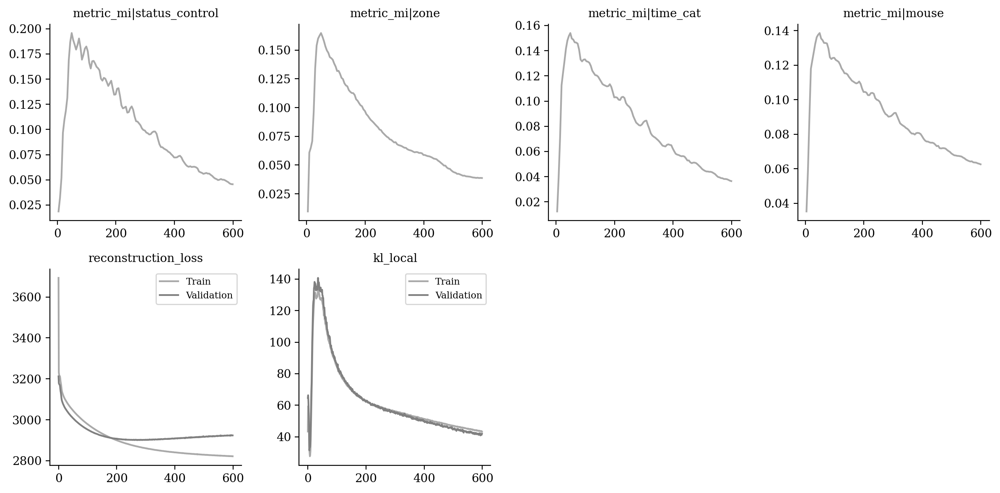

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

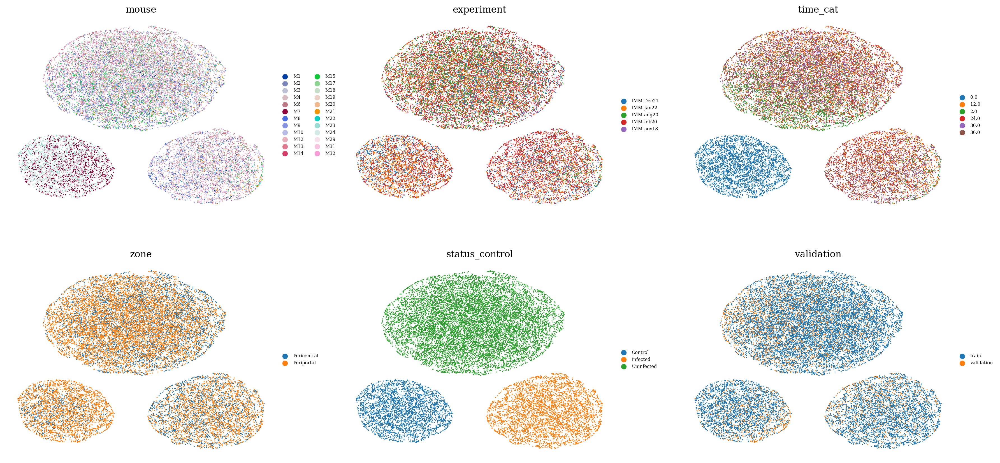

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

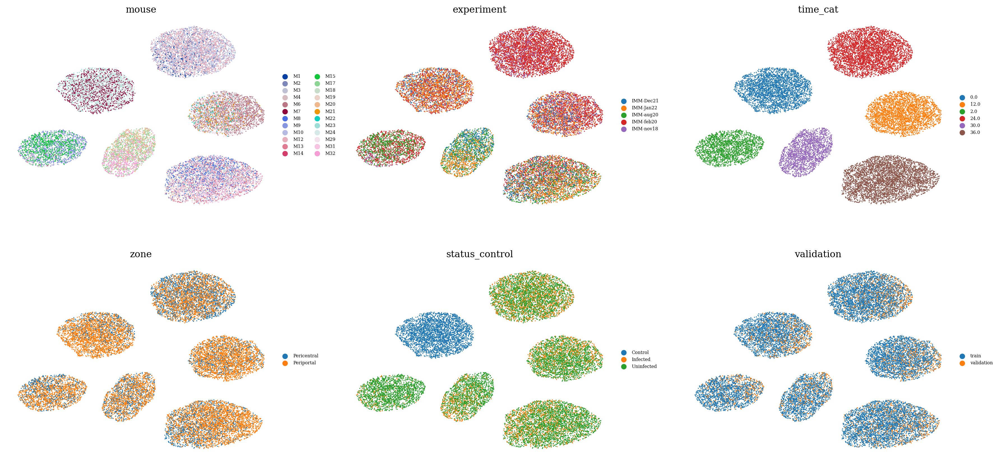

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

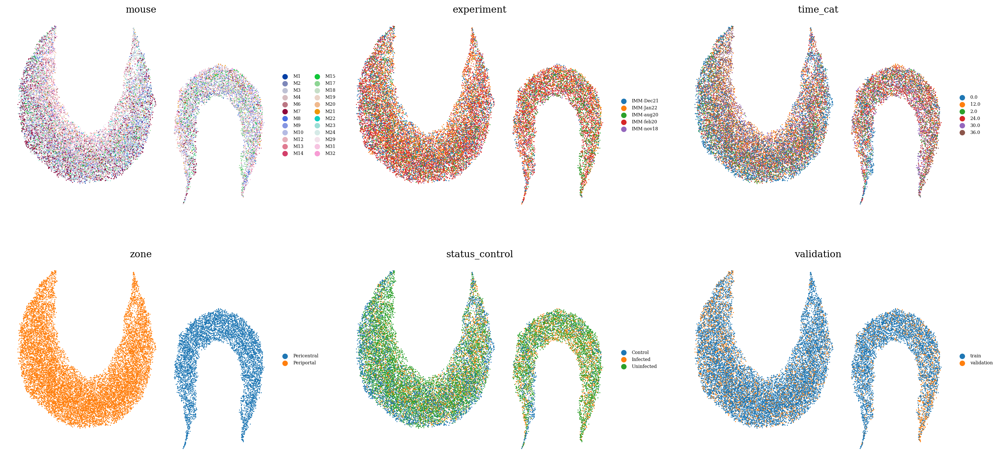

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

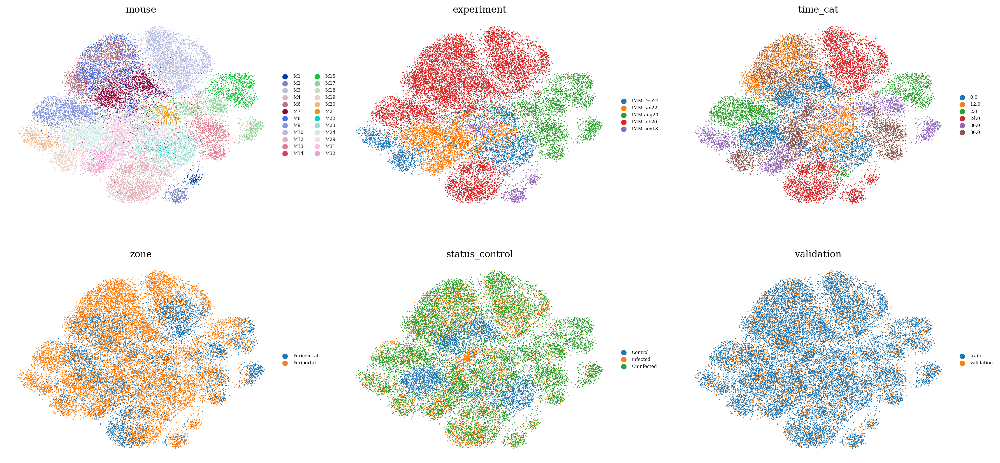

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

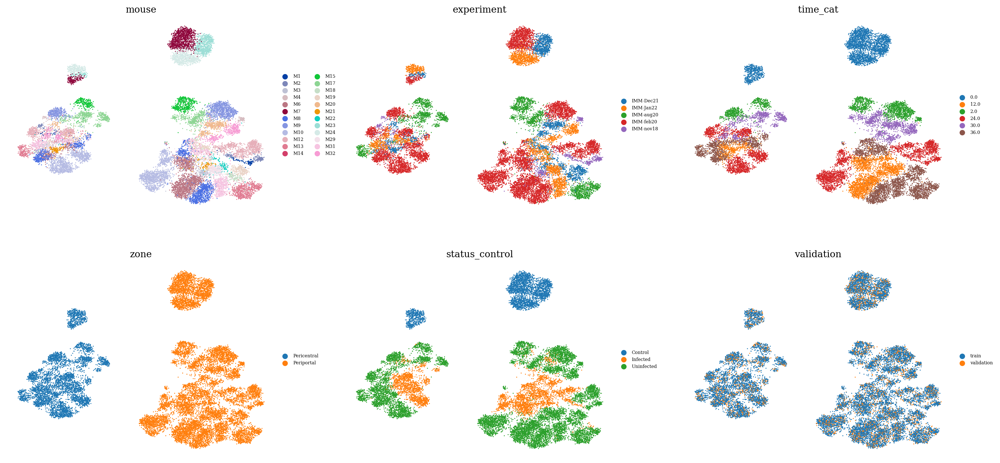

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

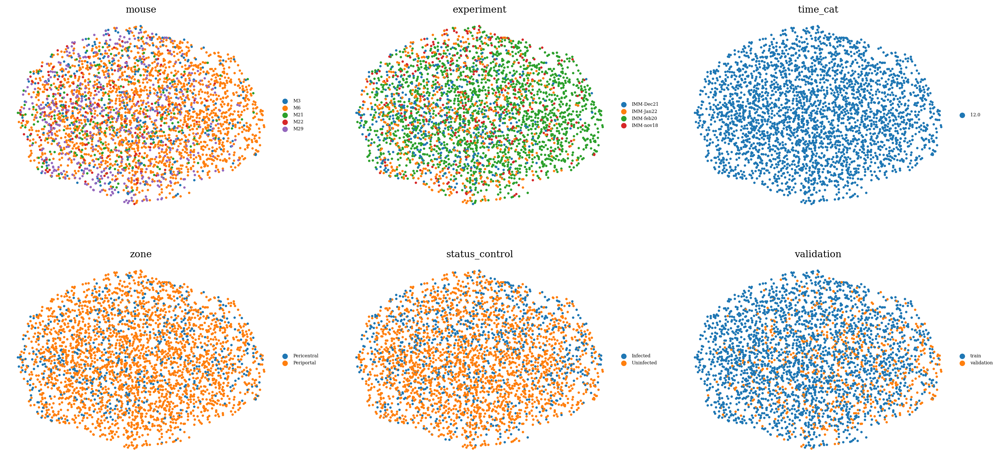

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )